# Let's train a deep segmentation model

We have learned various concepts related to segmentation models. Now let's see how can we apply these concepts to train a U-Net model to segment a dataset.

We will use [segmentation_models](https://github.com/qubvel/segmentation_models). It is a package for easy implementation of different models from scratch or use pretrained models. 

We will use simple dataset containing images of birds and insects. Following are some samples images in the dataset [Object Segmentation by Oriented Image Foresting Transform with Connectivity Constraints](http://www.vision.ime.usp.br/~lucyacm/thesis/coift.html)

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
import os
if not os.path.exists(os.path.join('/content', 'Data')):
  os.mkdir('/content/Data/')
  print('Created Data folder')

Created Data folder


In [3]:
import zipfile
with zipfile.ZipFile('/content/drive/My Drive/Data/data.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/Data/')

In [4]:
!pip install tensorflow_gpu==2.0.0
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

import cv2
from tensorflow import keras
import random
import imutils
import numpy as np
from tqdm import tqdm_notebook
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

     |████████████████████████████████| 380.8MB 42kB/s 
     |████████████████████████████████| 3.8MB 49.1MB/s 
     |████████████████████████████████| 51kB 6.3MB/s 
     |████████████████████████████████| 450kB 49.5MB/s 
  Created wheel for gast: filename=gast-0.2.2-cp36-none-any.whl size=7542 sha256=3ba7f0f6d51d583add59f1b62b6954f0cd02a38bf01f12914f33132052c5193b
  Stored in directory: /root/.cache/pip/wheels/5c/2e/7e/a1d4d4fcebe6c381f378ce7743a3ced3699feb89bcfbdadadd
Successfully built gast
ERROR: tensorflow 2.3.0 has requirement gast==0.3.3, but you'll have gast 0.2.2 which is incompatible.
ERROR: tensorflow 2.3.0 has requirement tensorboard<3,>=2.3.0, but you'll have tensorboard 2.0.2 which is incompatible.
ERROR: tensorflow 2.3.0 has requirement tensorflow-estimator<2.4.0,>=2.3.0, but you'll have tensorflow-estimator 2.0.1 which is incompatible.
ERROR: tensorflow-probability 0.11.0 has requirement gast>=0.3.2, but you'll have gast 0.2.2 which is incompatible.
  Found existing ins

## Reading Dataset

Let's look at some samples from the dataset. 

In [5]:
DATA_DIR = '/content/Data'

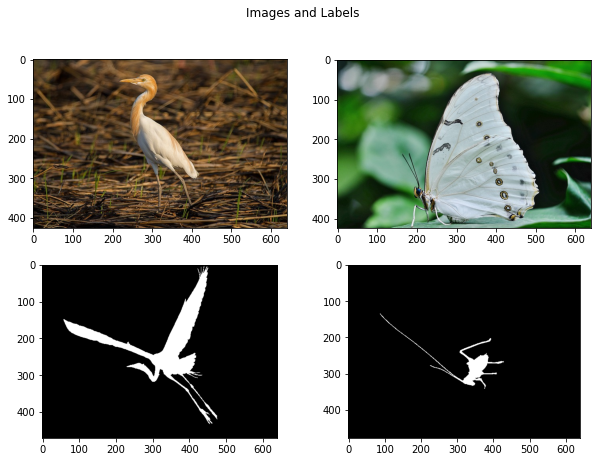

In [6]:
f, ax = plt.subplots(2, 2, figsize = (10, 7))
ax[0][0].imshow(cv2.cvtColor(cv2.imread('{}//images//bird//{}'.format(DATA_DIR, os.listdir(os.path.join(DATA_DIR, 'images', 'bird'))[0])), cv2.COLOR_BGR2RGB))
ax[0][1].imshow(cv2.cvtColor(cv2.imread('{}//images//insect//{}'.format(DATA_DIR, os.listdir(os.path.join(DATA_DIR, 'images', 'insect'))[0])), cv2.COLOR_BGR2RGB))
ax[1][0].imshow(cv2.imread('{}//labels//bird//{}'.format(DATA_DIR, os.listdir(os.path.join(DATA_DIR, 'labels', 'bird'))[0])))
ax[1][1].imshow(cv2.imread('{}//labels//insect//{}'.format(DATA_DIR, os.listdir(os.path.join(DATA_DIR, 'labels', 'insect'))[0])))
plt.suptitle('Images and Labels')
plt.show()

## Processing Dataset

Below is the code for processing the dataset and placing them in a new directory for easy ingestion into the segementation model.

In [7]:
seed = 5

In [8]:
images = os.listdir(os.path.join(DATA_DIR, 'images', 'bird')) + os.listdir(os.path.join(DATA_DIR, 'images', 'insect'))
masks = os.listdir(os.path.join(DATA_DIR, 'labels', 'bird')) + os.listdir(os.path.join(DATA_DIR, 'labels', 'insect'))
labels = [1]*len(os.listdir(os.path.join(DATA_DIR, 'labels', 'bird'))) + [2]*len(os.listdir(os.path.join(DATA_DIR, 'labels', 'insect')))

In [9]:
indices = np.arange(len(images))

In [10]:
assert len(images) == len(masks)
assert len(masks) == len(labels)

In [11]:
widths = []
heights = []
for i, image in tqdm_notebook(enumerate(images), total = len(images)):
    im = cv2.imread('{}//images//{}//{}'.format(DATA_DIR, 'bird' if labels[i]==1 else 'insect', image))
    
    widths.append(im.shape[0])
    heights.append(im.shape[1])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


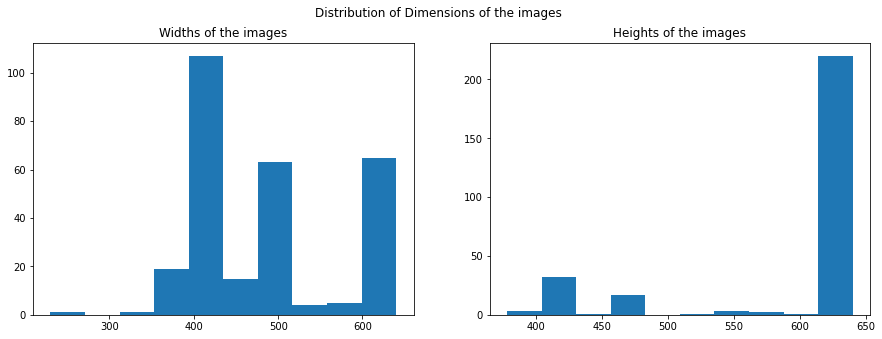

In [12]:
f, ax = plt.subplots(1, 2, figsize = (15, 5))
ax[0].hist(widths)
ax[1].hist(heights)
ax[0].set_title('Widths of the images')
ax[1].set_title('Heights of the images')
plt.suptitle('Distribution of Dimensions of the images')
plt.show()

In [13]:
def pad_images_to_same_size(images):
    """
    :param images: sequence of images
    :return: list of images padded so that all images have same width and height (max width and height are used)
    """
    width_max = 640
    height_max = 640
    
    for img in images:
        h, w = img.shape[0], img.shape[1]
        width_max = max(width_max, w)
        height_max = max(height_max, h)

    images_padded = []
    for img in images:
        h, w = img.shape[0], img.shape[1]
        diff_vert = height_max - h
        pad_top = diff_vert//2
        pad_bottom = diff_vert - pad_top
        diff_hori = width_max - w
        pad_left = diff_hori//2
        pad_right = diff_hori - pad_left
        img_padded = cv2.copyMakeBorder(img, pad_top, pad_bottom, pad_left, pad_right, cv2.BORDER_CONSTANT, value=0)
        assert img_padded.shape[:2] == (height_max, width_max)
        images_padded.append(img_padded)

    return images_padded

def readpgm(ID):
        
        with open(ID) as f:

            lines = f.readlines()

        # This ignores commented lines

        for l in list(lines):

            if l[0] == '#':

                lines.remove(l)

        # here,it makes sure it is ASCII format (P2)

        assert lines[0].strip() == 'P2' 

        # Converts data to a list of integers

        data = []

        for line in lines[1:]:

            data.extend([int(c) for c in line.split()])

        return np.array(data[3:]).reshape((data[1],data[0]))*255

In [14]:
if not os.path.exists(os.path.join(DATA_DIR, 'images_')):
    os.mkdir(os.path.join(DATA_DIR, 'images_'))
    os.mkdir(os.path.join(DATA_DIR, 'images_', 'bird'))
    os.mkdir(os.path.join(DATA_DIR, 'images_', 'insect'))
    
if not os.path.exists(os.path.join(DATA_DIR, 'labels_')):
    os.mkdir(os.path.join(DATA_DIR, 'labels_'))
    os.mkdir(os.path.join(DATA_DIR, 'labels_', 'bird'))
    os.mkdir(os.path.join(DATA_DIR, 'labels_', 'insect'))

In [15]:
for i, idx in tqdm_notebook(enumerate(indices), total = len(indices)):
    im_path = '{}//images//{}//'.format(DATA_DIR, 'bird' if labels[idx]==1 else 'insect')
    mask_path = '{}//labels//{}//'.format(DATA_DIR, 'bird' if labels[idx]==1 else 'insect')
    im = cv2.cvtColor(cv2.imread('{}{}'.format(im_path, images[idx])), cv2.COLOR_BGR2RGB)
    mask = readpgm('{}{}'.format(mask_path, masks[idx]))
    
    im_ = pad_images_to_same_size([im])[0]
    mask_ = pad_images_to_same_size([mask])[0]
    
    im_path = '{}//images_//{}//'.format(DATA_DIR, 'bird' if labels[idx]==1 else 'insect')
    mask_path = '{}//labels_//{}//'.format(DATA_DIR, 'bird' if labels[idx]==1 else 'insect')

    cv2.imwrite('{}//{}'.format(im_path, images[idx]), cv2.cvtColor(im_, cv2.COLOR_RGB2BGR))
    cv2.imwrite('{}//{}'.format(mask_path, '{}.jpg'.format(masks[idx].split('.')[0])), mask_)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


## Building the Data Generator

In [16]:
images = sorted(os.listdir(os.path.join(DATA_DIR, 'images_', 'bird')) + os.listdir(os.path.join(DATA_DIR, 'images_', 'insect')))
masks = os.listdir(os.path.join(DATA_DIR, 'labels_', 'bird')) + os.listdir(os.path.join(DATA_DIR, 'labels_', 'insect'))
labels = [1]*len(os.listdir(os.path.join(DATA_DIR, 'labels_', 'bird'))) + [2]*len(os.listdir(os.path.join(DATA_DIR, 'labels_', 'insect')))
pairs = zip(masks, labels)
pairs = sorted(pairs, key = lambda x: x[0])
masks  = [i for i, j in pairs]
labels  = [j for i, j in pairs]

In [17]:
assert len(images) == len(masks) and len(images) > 0
assert len(masks) == len(labels) and len(masks) > 0

In [18]:
print(images[:5])
print(masks[:5])
print(labels[:5])

['abdims-stork-505313_640.jpg', 'africa-164205_640.jpg', 'africa-2599_640.jpg', 'animal-1065693_640.jpg', 'animal-1281879_640.jpg']
['abdims-stork-505313_640_label.jpg', 'africa-164205_640_label.jpg', 'africa-2599_640_label.jpg', 'animal-1065693_640_label.jpg', 'animal-1281879_640_label.jpg']
[1, 1, 1, 1, 2]


In [19]:
indices = np.arange(len(images))

In [20]:
widths = []
heights = []
for i, image in tqdm_notebook(enumerate(images), total = len(images)):
    im = cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if labels[i]==1 else 'insect', image))
    
    widths.append(im.shape[0])
    heights.append(im.shape[1])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


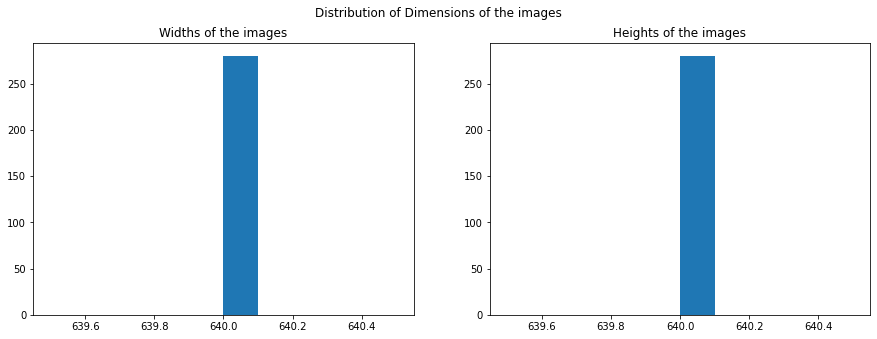

In [21]:
f, ax = plt.subplots(1, 2, figsize = (15, 5))
ax[0].hist(widths)
ax[1].hist(heights)
ax[0].set_title('Widths of the images')
ax[1].set_title('Heights of the images')
plt.suptitle('Distribution of Dimensions of the images')
plt.show()

## Splitting the dataset into train and test

In [22]:
x_train, x_, y_train, y_ = train_test_split(indices, labels, test_size = 0.5, random_state = seed, stratify = labels)
x_val, x_test, y_val, y_test = train_test_split(x_, y_, test_size = 0.6, random_state = seed, stratify = y_)

In [23]:
from collections import Counter
print(Counter(y_train))
print(Counter(y_val))
print(Counter(y_test))

Counter({1: 75, 2: 65})
Counter({1: 30, 2: 26})
Counter({1: 45, 2: 39})


In [24]:
print('Train {}, Val {}, Test {}'.format(len(x_train), len(x_val), len(x_test)))

Train 140, Val 56, Test 84


In [25]:
if not os.path.exists(os.path.join(DATA_DIR, 'train')) or not os.path.exists(os.path.join(DATA_DIR, 'val')) or not os.path.exists(os.path.join(DATA_DIR, 'test')):
        os.mkdir(os.path.join(DATA_DIR, 'train'))
        os.mkdir(os.path.join(DATA_DIR, 'trainannot'))
        os.mkdir(os.path.join(DATA_DIR, 'val'))
        os.mkdir(os.path.join(DATA_DIR, 'valannot'))
        os.mkdir(os.path.join(DATA_DIR, 'test'))
        os.mkdir(os.path.join(DATA_DIR, 'testannot'))

In [26]:
for idx, l in tqdm_notebook(zip(x_train, y_train), total = len(x_train)):
    x = cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', images[idx]))
    y = cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', masks[idx]))
    
    cv2.imwrite('{}//train//{}'.format(DATA_DIR, images[idx]), x)
    cv2.imwrite('{}//trainannot//{}_{}.jpg'.format(DATA_DIR, masks[idx].split('.')[0], l), y)
    
for idx, l in tqdm_notebook(zip(x_val, y_val), total = len(x_val)):
    x = cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', images[idx]))
    y = cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', masks[idx]))
    
    cv2.imwrite('{}//val//{}'.format(DATA_DIR, images[idx]), x)
    cv2.imwrite('{}//valannot//{}_{}.jpg'.format(DATA_DIR, masks[idx].split('.')[0], l), y)
    
for idx, l in tqdm_notebook(zip(x_test, y_test), total = len(x_test)):
    x = cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', images[idx]))
    y = cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if l==1 else 'insect', masks[idx]))
    
    cv2.imwrite('{}//test//{}'.format(DATA_DIR, images[idx]), x)
    cv2.imwrite('{}//testannot//{}_{}.jpg'.format(DATA_DIR, masks[idx].split('.')[0], l), y)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  from ipykernel import kernelapp as app


     |████████████████████████████████| 122kB 5.4MB/s 
     |████████████████████████████████| 634kB 18.1MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.5-cp36-none-any.whl size=64378 sha256=a89f6e61a1181baa7312f78680d8c8118f3b7eeba9a95c18033111f0d290e7b9
  Stored in directory: /root/.cache/pip/wheels/f0/a0/61/e50f93165a5ec7e7f5d65064e513239505bc4c06d2289557d3
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654021 sha256=99fafef7be2c0f76338b38f4e5952b2e39c20445fca463cf4d07480dd4c943ce
  Stored in directory: /root/.cache/pip/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built albumentations imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12
     |████████████████████████████████| 952kB 4.9M

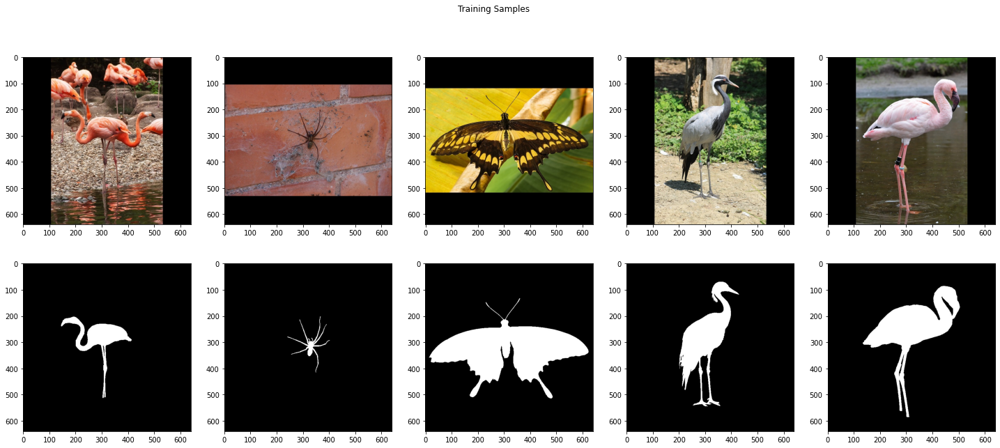

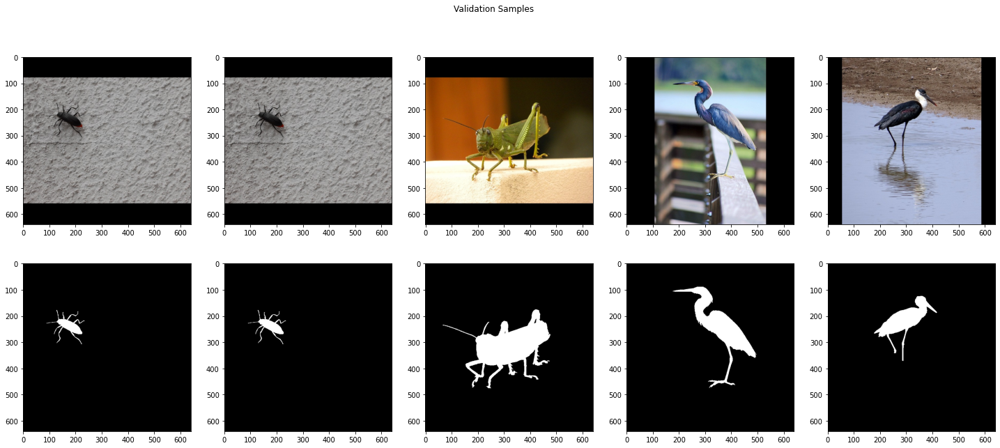

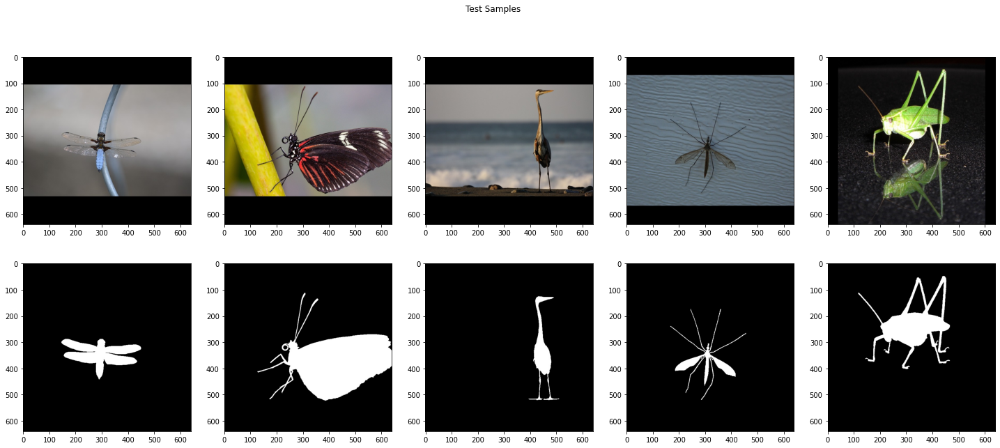

In [27]:
# helper function for data visualization
!pip install albumentations==0.4.5
!pip install imgaug==0.4.0
from imgaug import SegmentationMapsOnImage

def visualize(images, masks, title):
    
    f, ax = plt.subplots(2, len(images), figsize = (25, 10))
    for i, (im, ms) in enumerate(zip(images, masks)):
        
        ax[0][i].imshow(im)
        ax[1][i].imshow(ms, cmap = 'gray')
    plt.suptitle(title)
    plt.show()
        
sample = random.choices(np.arange(len(x_train)), k = 5)
imgs = [cv2.cvtColor(cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if y_train[i]==1 else 'insect', images[x_train[i]])), cv2.COLOR_BGR2RGB) for i in sample]
msks = [cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if y_train[i]==1 else 'insect', masks[x_train[i]])) for i in sample]
visualize(imgs, msks, title = 'Training Samples')

sample = random.choices(np.arange(len(x_val)), k = 5)
imgs = [cv2.cvtColor(cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if y_val[i]==1 else 'insect', images[x_val[i]])), cv2.COLOR_BGR2RGB) for i in sample]
msks = [cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if y_val[i]==1 else 'insect', masks[x_val[i]])) for i in sample]
visualize(imgs, msks, title = 'Validation Samples')

sample = random.choices(np.arange(len(x_test)), k = 5)
imgs = [cv2.cvtColor(cv2.imread('{}//images_//{}//{}'.format(DATA_DIR, 'bird' if y_test[i]==1 else 'insect', images[x_test[i]])), cv2.COLOR_BGR2RGB) for i in sample]
msks = [cv2.imread('{}//labels_//{}//{}'.format(DATA_DIR, 'bird' if y_test[i]==1 else 'insect', masks[x_test[i]])) for i in sample]
visualize(imgs, msks, title = 'Test Samples')

In [28]:
# helper function for data visualization

def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if(len(image.shape) == 2):
            plt.imshow(image, cmap = 'gray')
        else:
            plt.imshow(image)
    plt.show()
    
# helper function for data visualization    
def denormalize(x):
    """Scale image to range 0..1 for correct plot"""
    x_max = np.percentile(x, 98)
    x_min = np.percentile(x, 2)    
    x = (x - x_min) / (x_max - x_min)
    x = x.clip(0, 1)
    return x
    

# classes for data loading and preprocessing
class Dataset:
    """CamVid Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    def __init__(
            self, 
            images_dir, 
            masks_dir,
            mode = 'fit',
            classes=None, 
            reshape = None,
            augmentation=None, 
            preprocessing=None,
    ):
        self.ids = sorted(os.listdir(images_dir))
        self.mask_ids = sorted(os.listdir(masks_dir))
        self.images_fps = [os.path.join(images_dir, image_id) for image_id in self.ids]
        self.masks_fps = [os.path.join(masks_dir, image_id) for image_id in self.mask_ids]
        self.reshape = reshape
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        self.mode = mode
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        gt = cv2.imread(self.masks_fps[i])
        gt = cv2.cvtColor(gt, cv2.COLOR_BGR2GRAY)
        gt = gt/255.0
        
        # extract certain classes from mask (e.g. cars)
        label = int(self.mask_ids[i].split('.')[0][-1])
        mask = np.zeros((gt.shape[0], gt.shape[1], 3))
        
        if(label == 1):
            mask[:, :, 1] = gt
        else:
            mask[:, :, 2] = gt
        
        mask[:, :, 0] = 1 - gt

        # applying resize
        if self.reshape:
            image = imutils.resize(image, height = self.reshape[0])
            mask = imutils.resize(mask, height = self.reshape[0])
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        if self.mode == 'fit':
            return image, mask
        else:
            return image
        
    def __len__(self):
        return len(self.ids)
    
    
class Dataloader(keras.utils.Sequence):
    """Load data from dataset and form batches
    
    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """
    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))
        self.data_x = None
        self.data_y = None
        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data_x = []
        data_y = []
        for j in range(start, stop):
            x, y = self.dataset[j]
            data_x.append(x)
            data_y.append(y)

        self.data_x = data_x
        self.data_y = data_y
        
        # transpose list of lists
        # batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        # print(batch)

        return np.array(data_x), np.array(data_y)

    def __shape__(self):
      return self.data_x.shape
    
    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)   
            
import albumentations as A

def round_clip_0_1(x, **kwargs):
    return x.round().clip(0, 1)

# define heavy augmentations
def get_training_augmentation():
    train_transform = [

        A.HorizontalFlip(p=0.5),

        A.ShiftScaleRotate(scale_limit=0.5, rotate_limit=90, shift_limit=0.1, p=1, border_mode=0),

        A.PadIfNeeded(min_height=320, min_width=320, always_apply=True, border_mode=0),
        A.RandomCrop(height=320, width=320, always_apply=True),

        A.IAAAdditiveGaussianNoise(p=0.2),
        A.IAAPerspective(p=0.5),

        A.OneOf(
            [
                A.CLAHE(p=1),
                A.RandomBrightness(p=1),
                A.RandomGamma(p=1),
            ],
            p=0.9,
        ),

        A.OneOf(
            [
                A.IAASharpen(p=1),
                A.Blur(blur_limit=3, p=1),
                A.MotionBlur(blur_limit=3, p=1),
            ],
            p=0.9,
        ),

        A.OneOf(
            [
                A.RandomContrast(p=1),
                A.HueSaturationValue(p=1),
            ],
            p=0.9,
        ),
        A.Lambda(mask=round_clip_0_1)
    ]
    return A.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        A.PadIfNeeded(384, 480)
    ]
    return A.Compose(test_transform)

def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform
    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    
    """
    
    _transform = [
        A.Lambda(image=preprocessing_fn),
    ]
    return A.Compose(_transform)

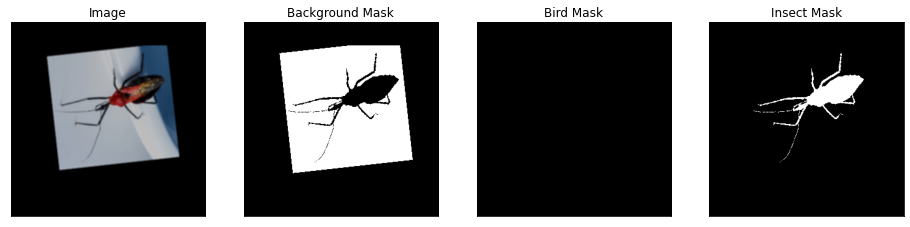

In [29]:
# Lets look at augmented data we have
dataset = Dataset('{}//train'.format(DATA_DIR), '{}//trainannot'.format(DATA_DIR), classes=['bird', 'insect'], 
                  reshape = (240, 240), augmentation=get_training_augmentation())

image, mask = dataset[5] # get some sample
visualize(
    image=image, 
    background_mask=mask[..., 0].squeeze(),
    bird_mask=mask[..., 1].squeeze(),
    insect_mask=mask[..., 2].squeeze(),    
)

## Building Segmentation Model

In [30]:
!pip install segmentation_models==1.0.1
import segmentation_models as sm

Segmentation Models: using `tf.keras` framework.


In [31]:
BACKBONE = 'efficientnetb3'
BATCH_SIZE = 1
CLASSES = ['bird', 'insect']
LR = 0.0001
EPOCHS = 100

preprocess_input = sm.get_preprocessing(BACKBONE)

In [32]:
# define network parameters
n_classes = 1 if len(CLASSES) == 1 else (len(CLASSES) + 1)  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)

44113920/44107200 [==============================] - 1s 0us/step


In [33]:
# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
# set class weights for dice_loss (car: 1.; pedestrian: 2.; background: 0.5;)
dice_loss = sm.losses.DiceLoss(class_weights=np.array([1, 1, 1])) 
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

In [34]:
# Dataset for train images
train_dataset = Dataset(
    '{}//train'.format(DATA_DIR), 
    '{}//trainannot'.format(DATA_DIR),
    reshape = (240, 240),
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    '{}//val'.format(DATA_DIR),
    '{}//valannot'.format(DATA_DIR),
    reshape = (240, 240),
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloader(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 320, 320, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 320, 320, n_classes)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint('/content/best_model_aug.h5', save_weights_only=True, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor = 'val_loss', patience = 7)
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3) (1, 320, 320, 3)


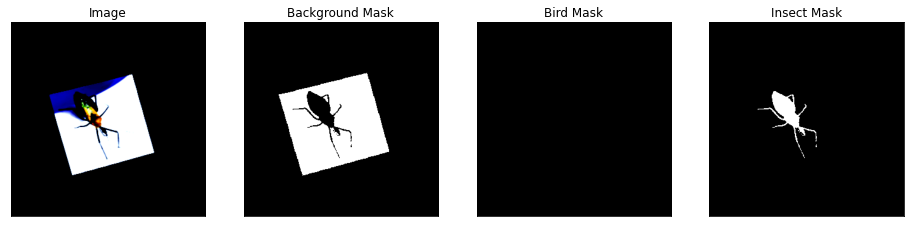

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 384, 480, 3) (1, 384, 480, 3)


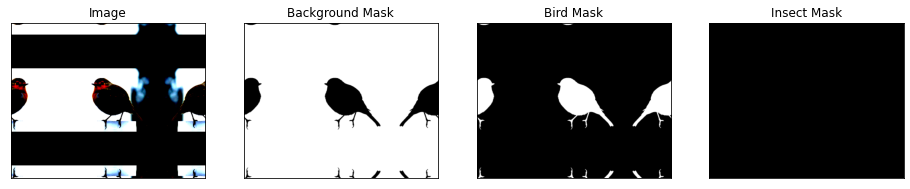

In [35]:
image, mask = train_dataloader[5] # get some sample
print(image.shape, mask.shape)
visualize(
    image=image[0, :, :, :], 
    background_mask=mask[0, :, :, 0],
    bird_mask=mask[0, :, :, 1],
    insect_mask=mask[0, :, :, 2],    
)

image, mask = valid_dataloader[5] # get some sample
print(image.shape, mask.shape)
visualize(
    image=image[0, :, :, :], 
    background_mask=mask[0, :, :, 0],
    bird_mask=mask[0, :, :, 1],
    insect_mask=mask[0, :, :, 2],    
)

In [37]:
# train model
history = model.fit_generator(
    train_dataloader, 
    steps_per_epoch= len(train_dataloader), 
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader, 
    validation_steps=len(valid_dataloader),
    verbose = 1
)

Epoch 1/100
140/140 [==============================] - 108s 769ms/step - loss: 0.5715 - iou_score: 0.4049 - f1-score: 0.4543 - val_loss: 0.7713 - val_iou_score: 0.3071 - val_f1-score: 0.3895
Epoch 2/100
140/140 [==============================] - 106s 756ms/step - loss: 0.5724 - iou_score: 0.4051 - f1-score: 0.4525 - val_loss: 0.7696 - val_iou_score: 0.3109 - val_f1-score: 0.3942
Epoch 3/100
140/140 [==============================] - 106s 759ms/step - loss: 0.5688 - iou_score: 0.4047 - f1-score: 0.4553 - val_loss: 0.8063 - val_iou_score: 0.3010 - val_f1-score: 0.3835
Epoch 4/100
140/140 [==============================] - 105s 747ms/step - loss: 0.5556 - iou_score: 0.4177 - f1-score: 0.4644 - val_loss: 0.7378 - val_iou_score: 0.3144 - val_f1-score: 0.3950
Epoch 5/100
140/140 [==============================] - 105s 748ms/step - loss: 0.5601 - iou_score: 0.4146 - f1-score: 0.4611 - val_loss: 0.8149 - val_iou_score: 0.3010 - val_f1-score: 0.3857
Epoch 6/100
140/140 [========================

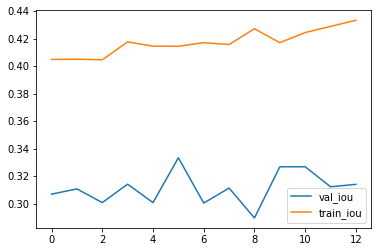

In [39]:
plt.plot(history.history['val_iou_score'], label = 'val_iou')
plt.plot(history.history['iou_score'], label = 'train_iou')
plt.legend()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


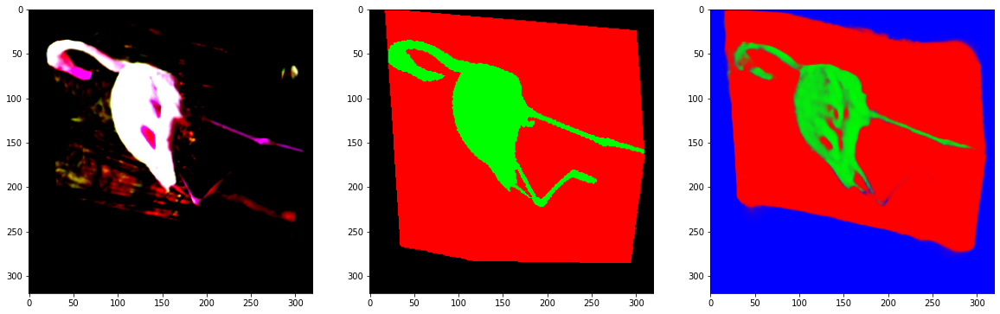

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


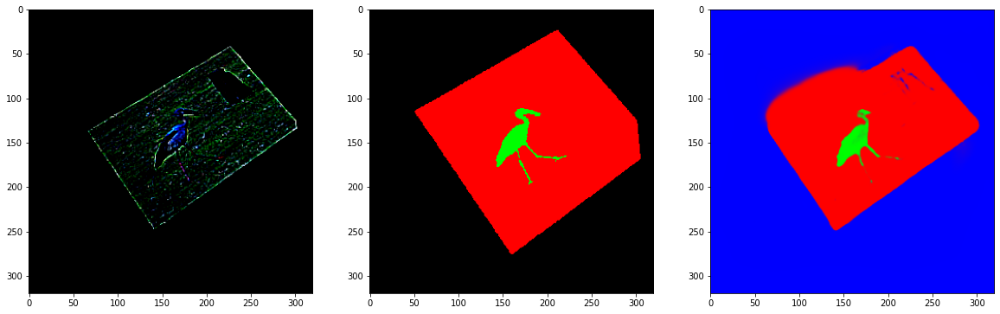

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


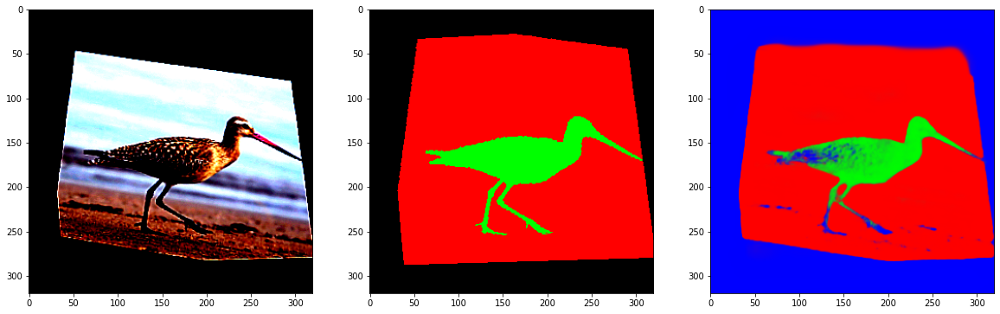

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


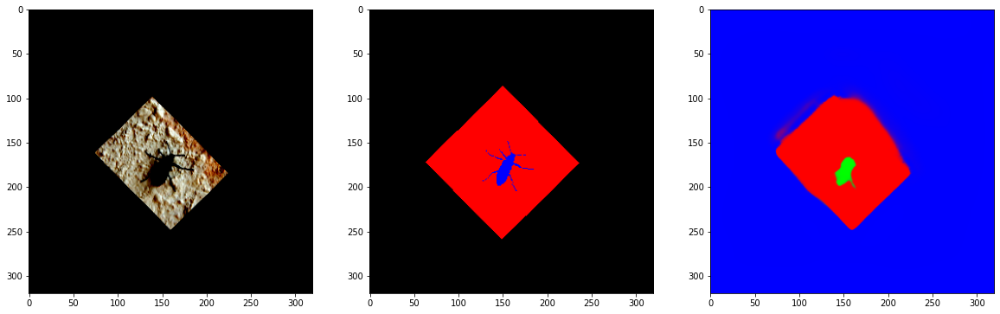

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


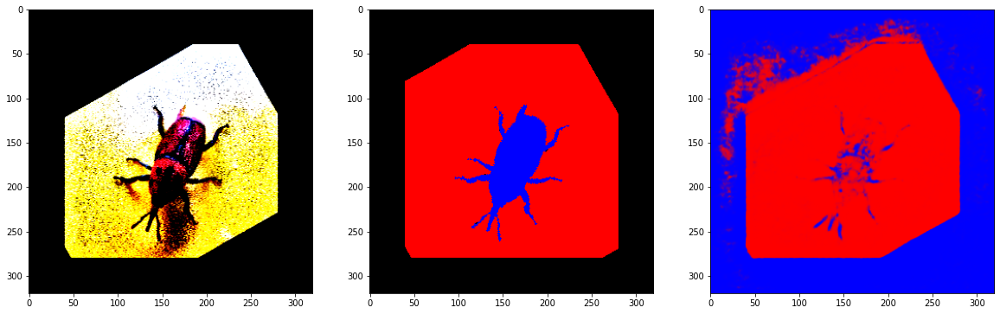

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


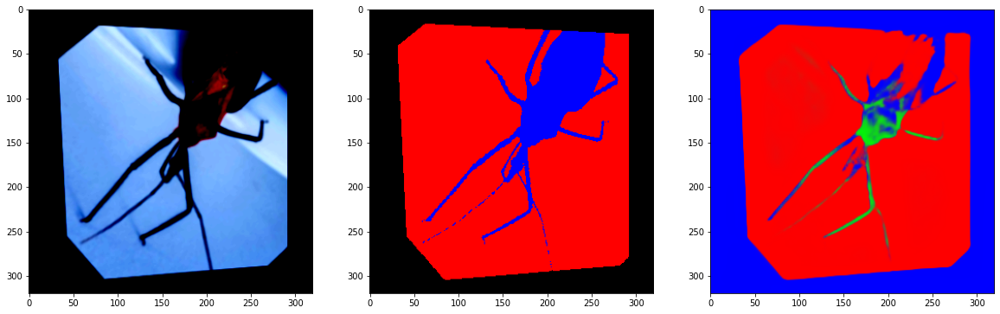

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


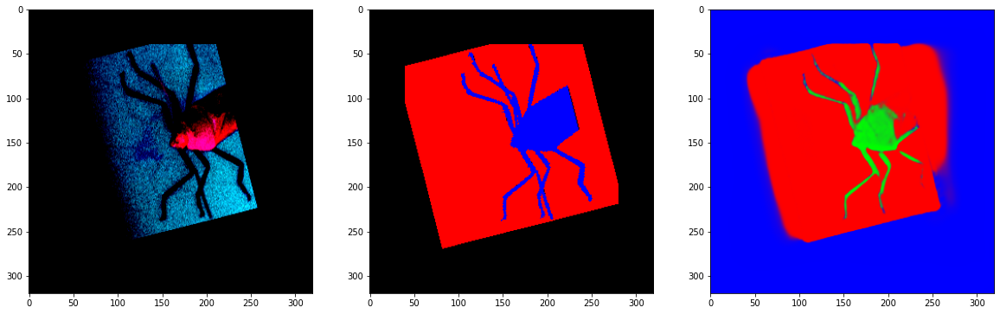

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


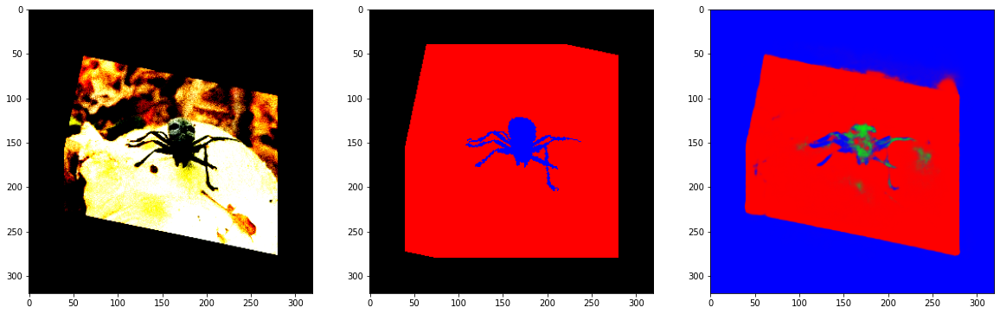

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


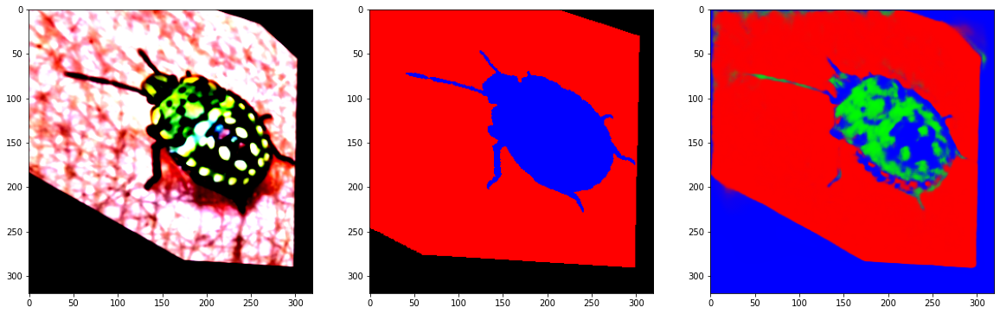

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


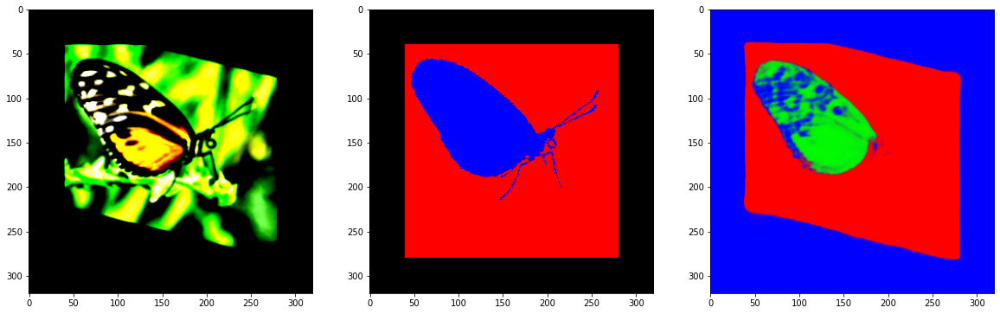

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


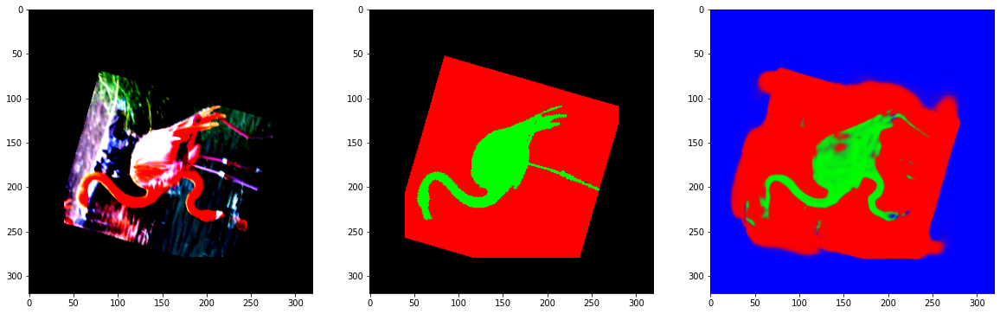

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


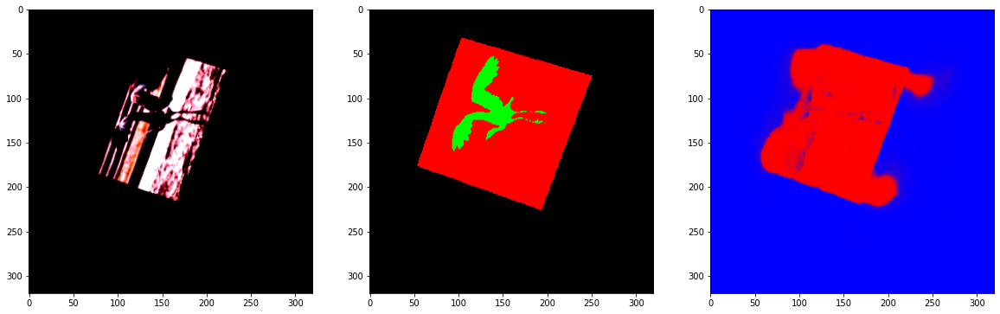

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


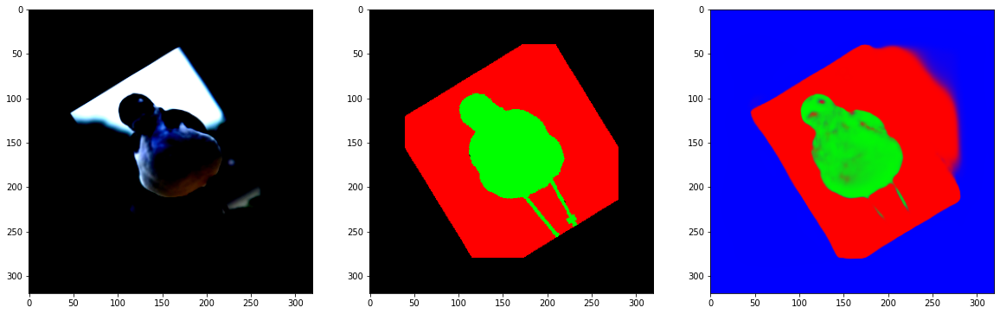

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


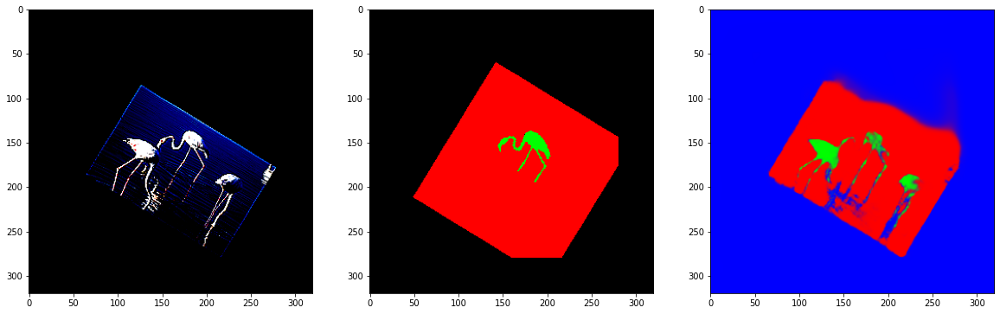

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


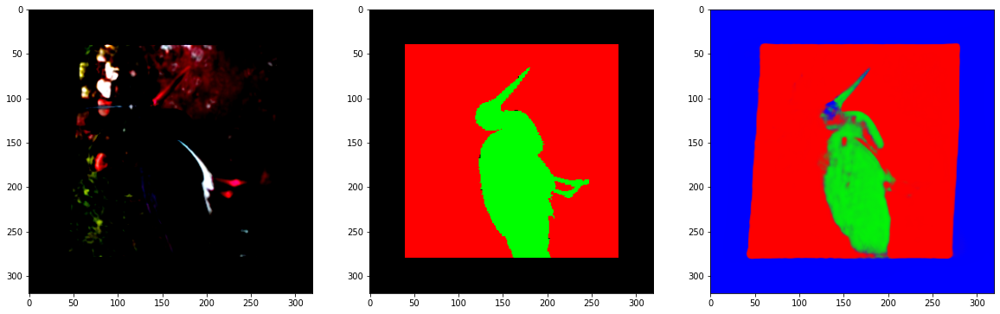

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


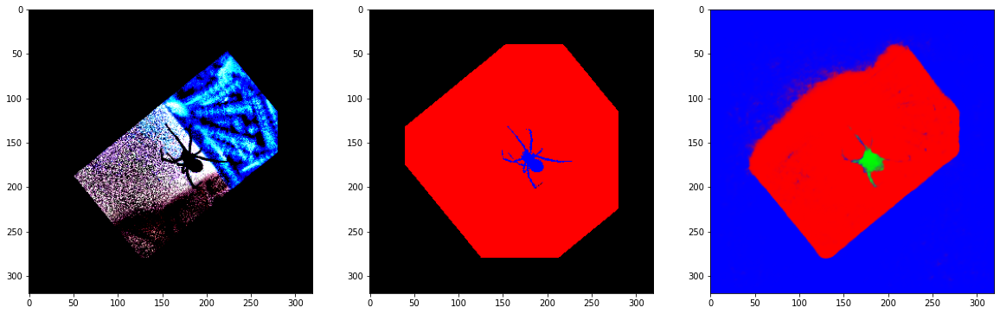

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


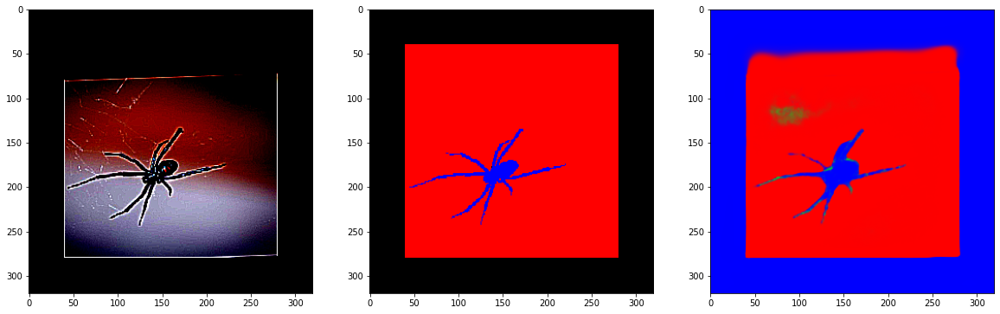

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


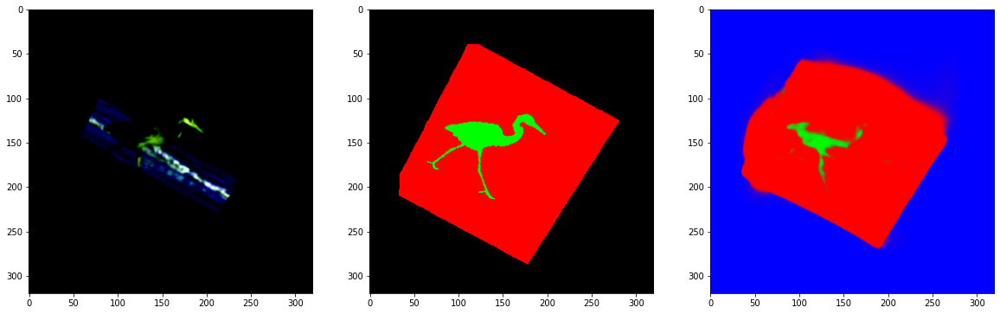

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


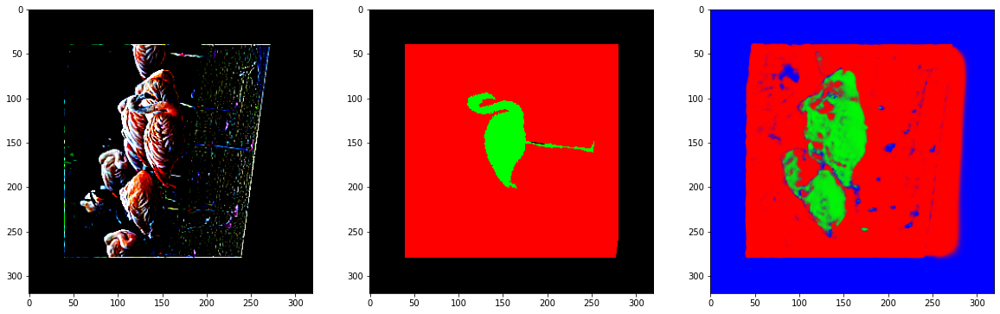

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


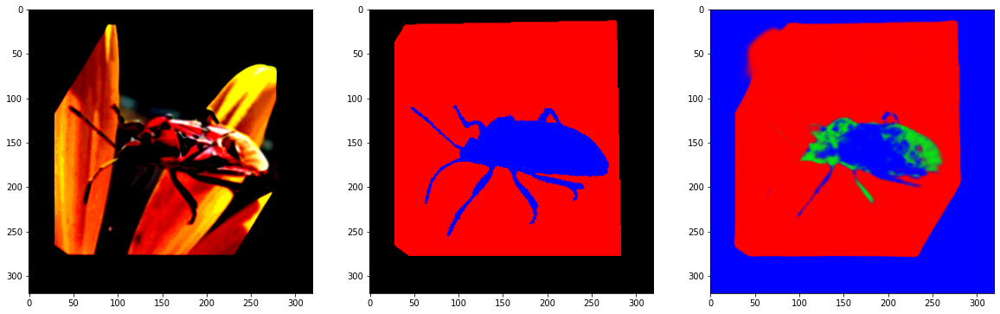

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


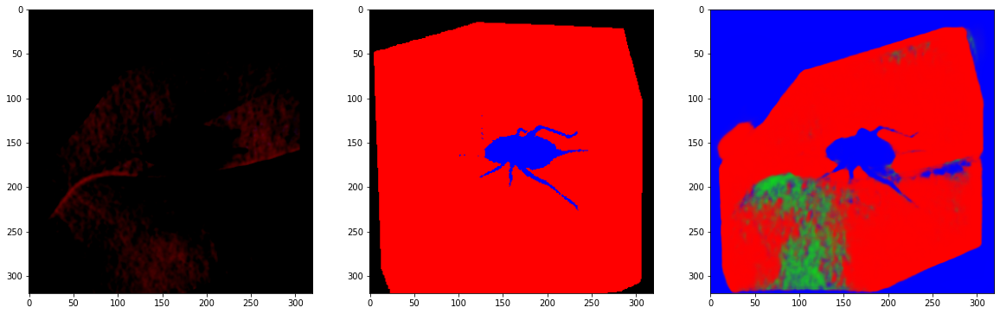

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


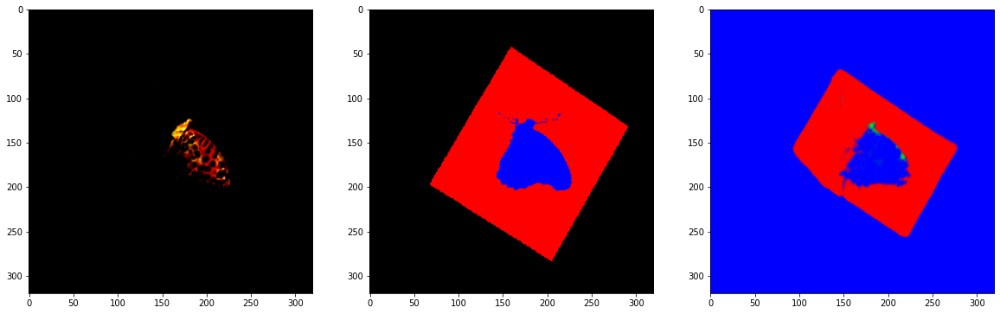

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


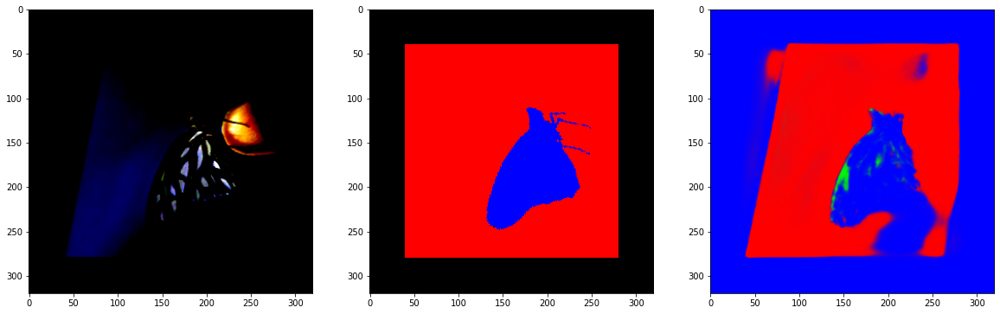

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


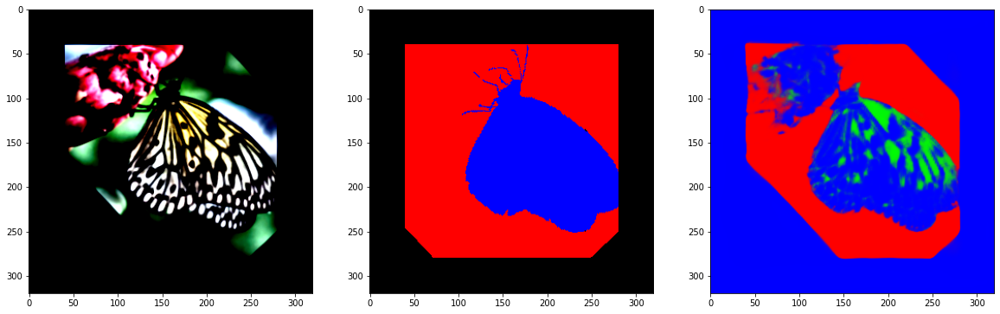

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


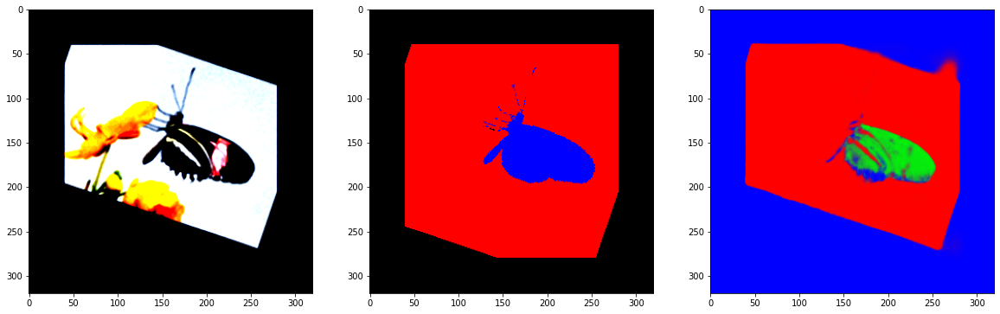

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


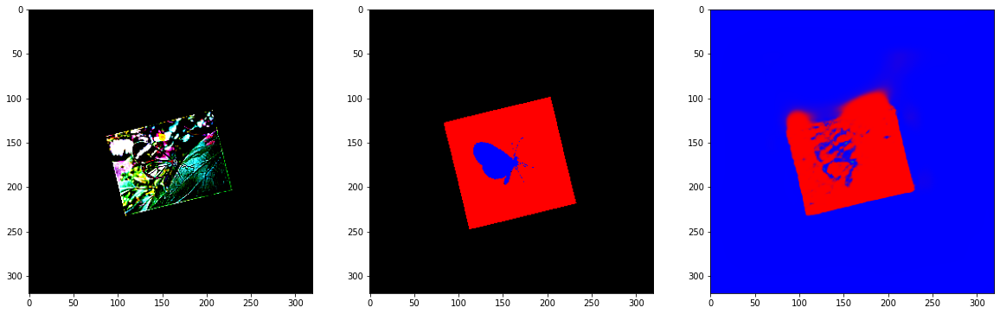

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


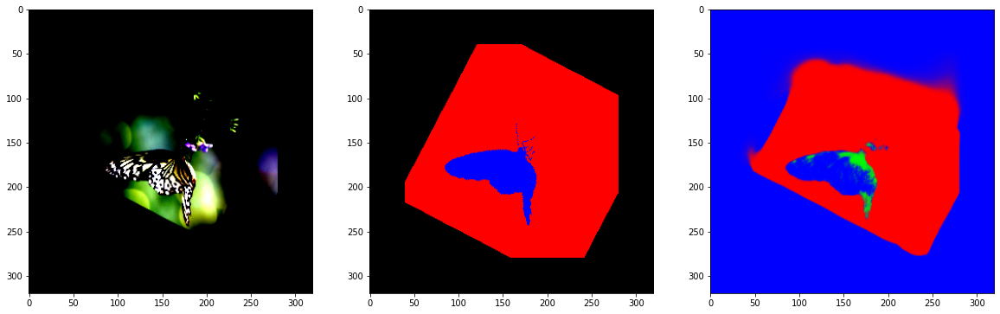

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


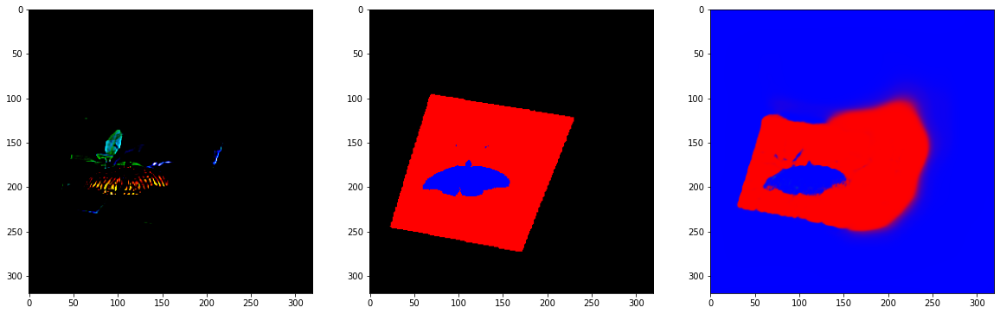

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


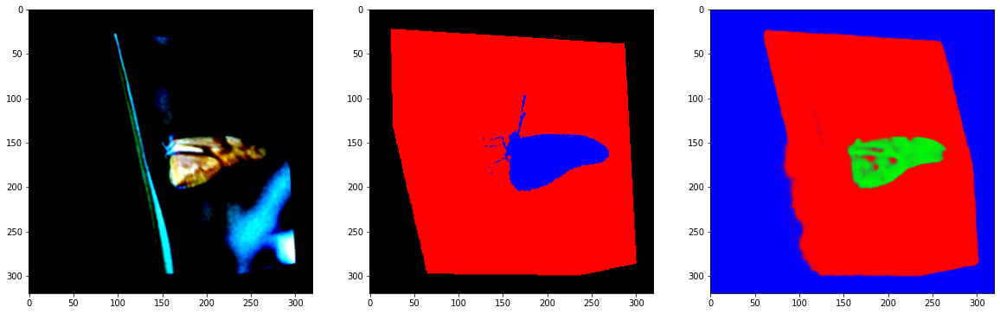

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


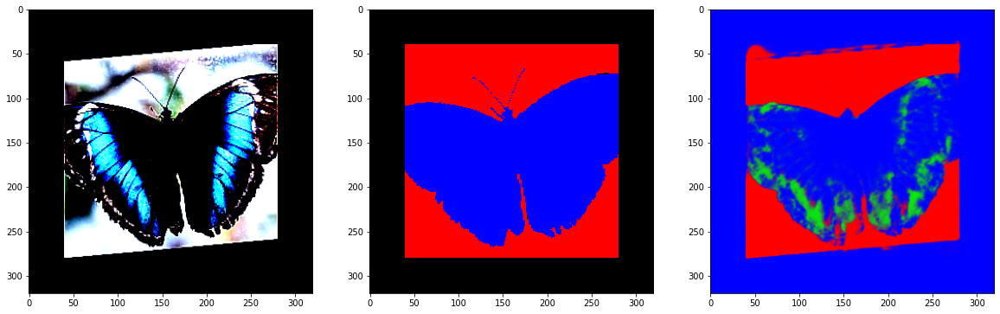

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


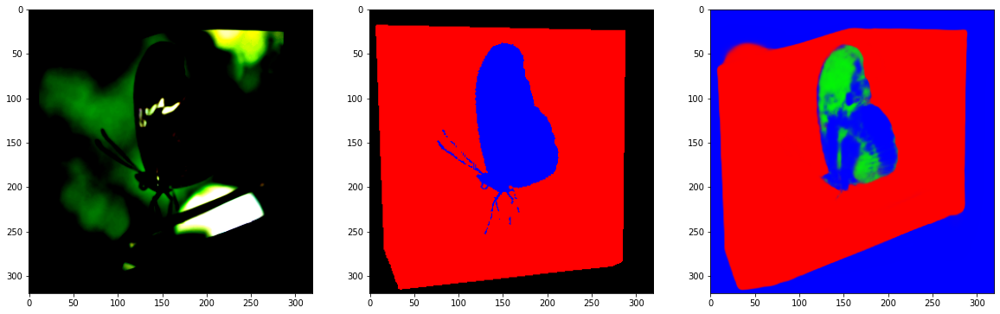

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


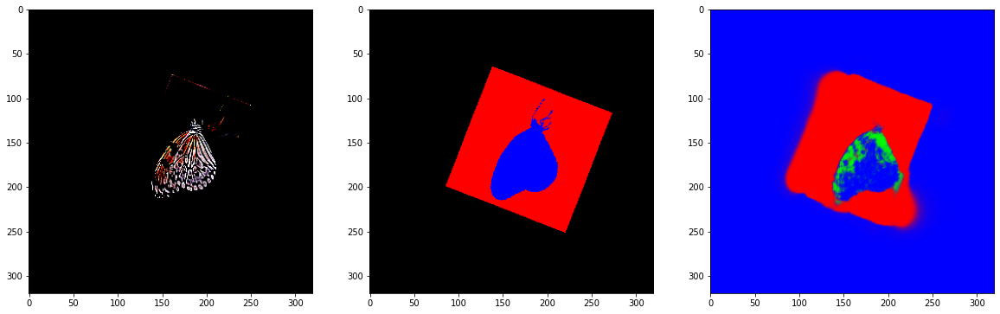

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


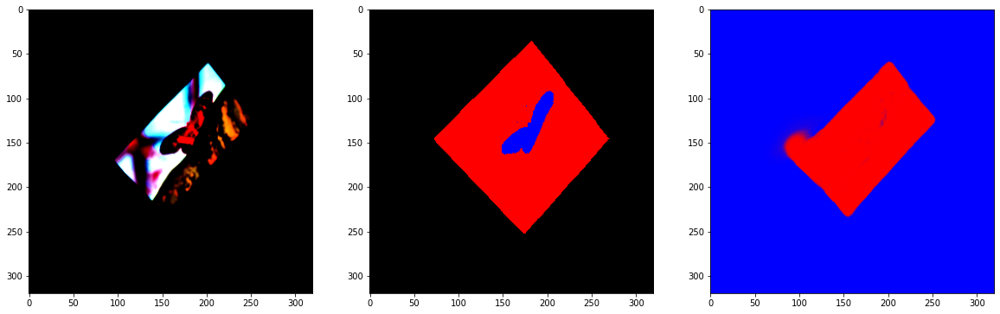

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


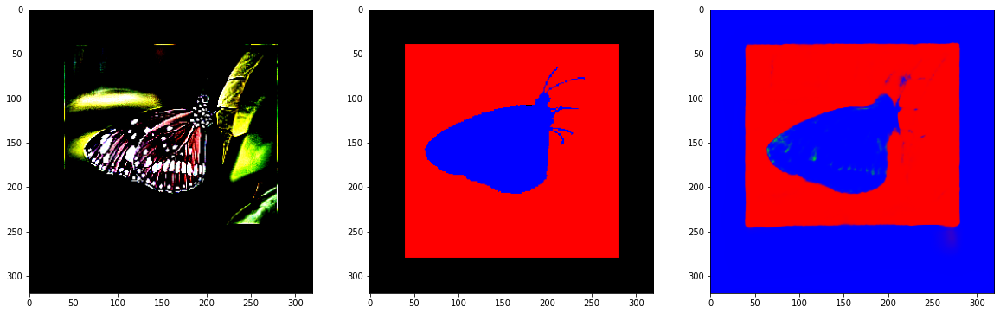

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


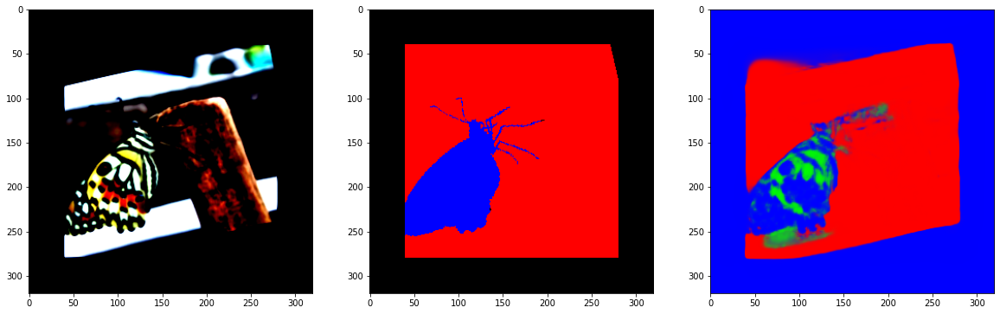

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


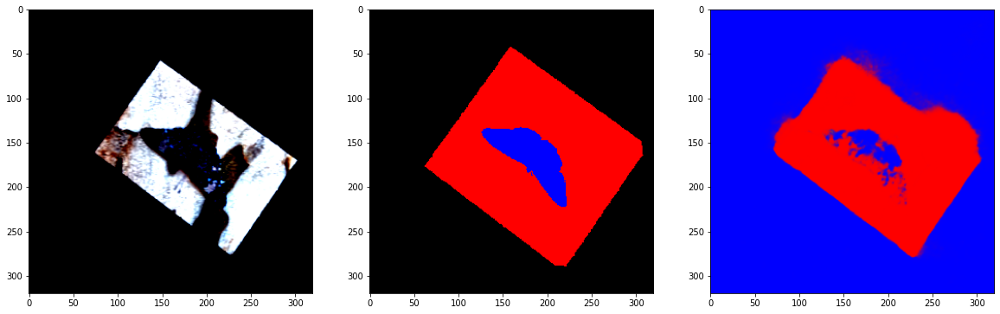

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


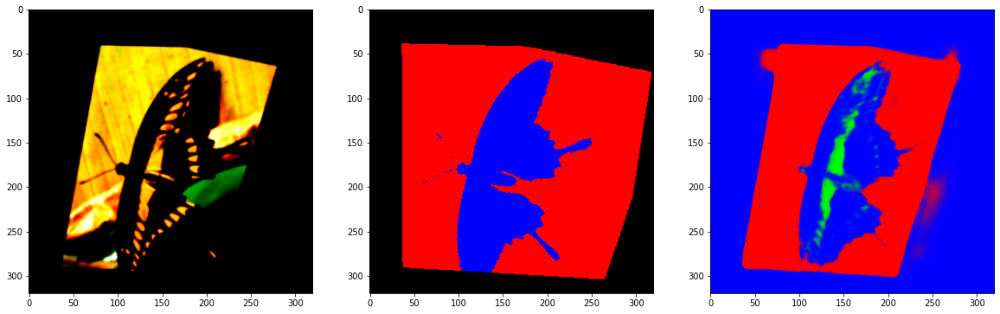

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


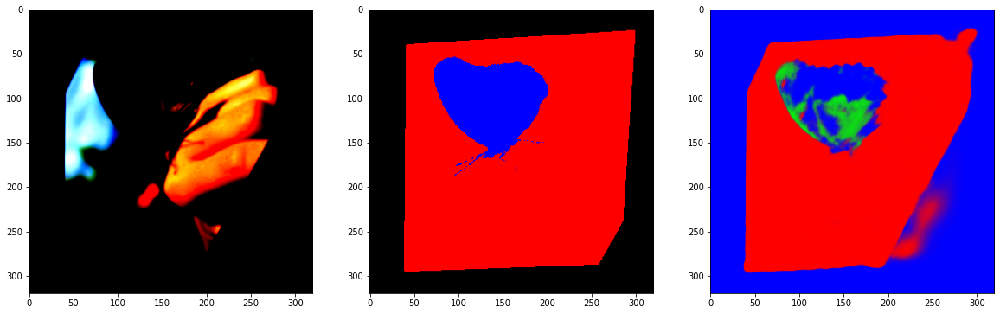

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


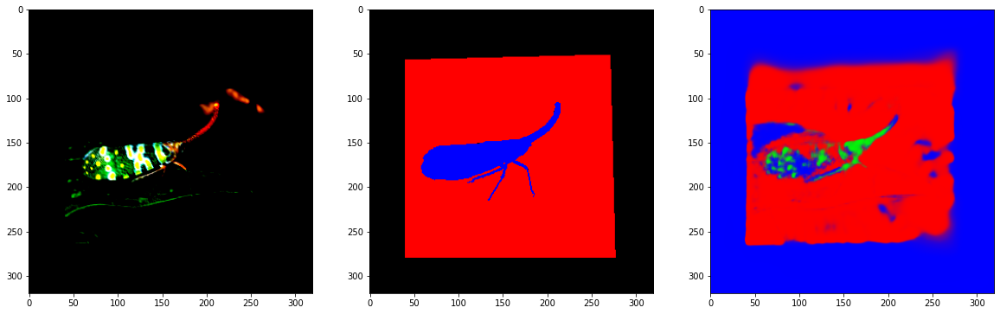

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


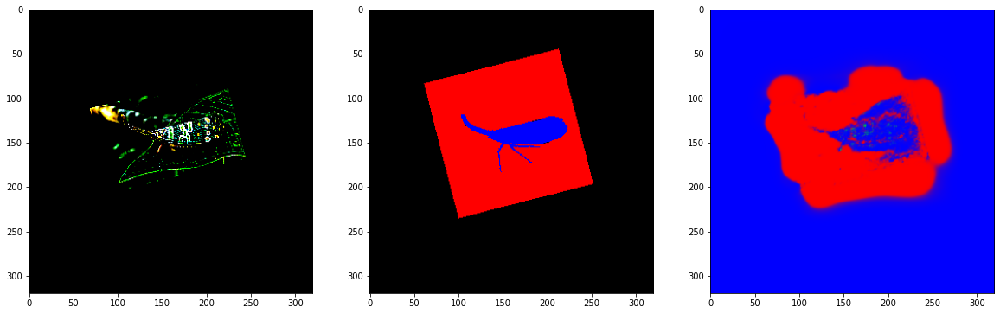

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


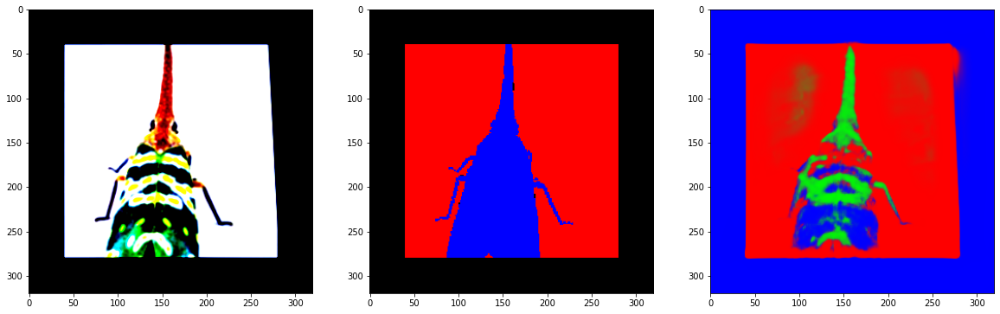

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


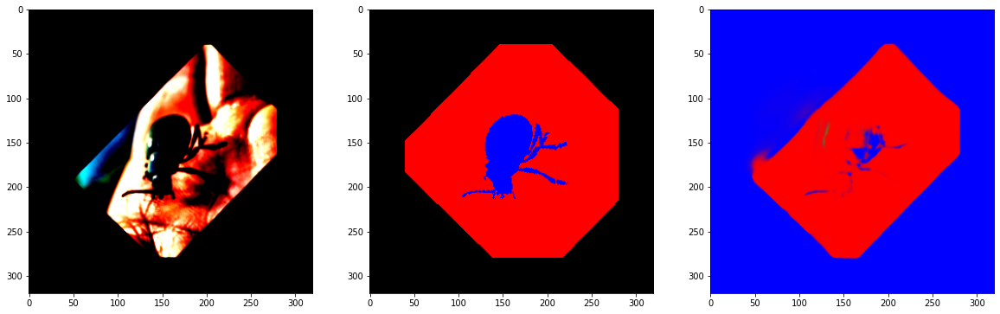

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


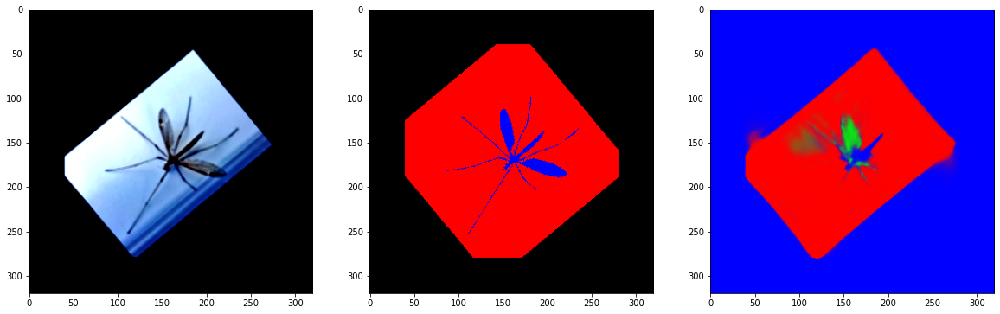

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


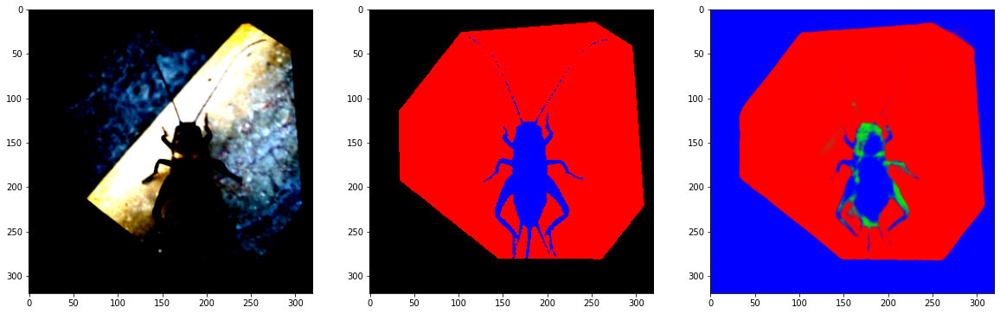

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


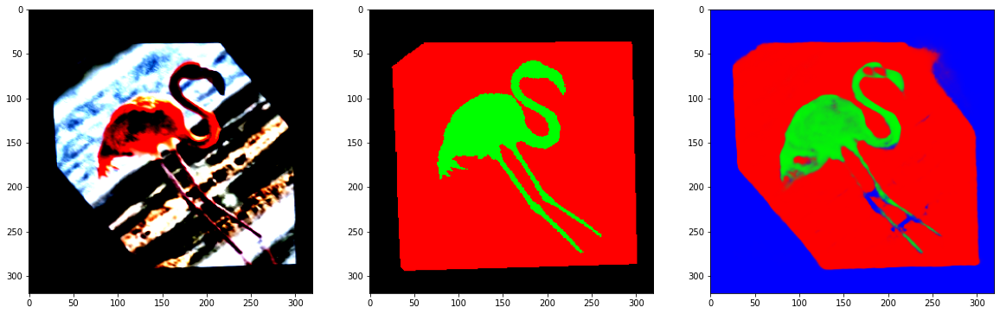

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


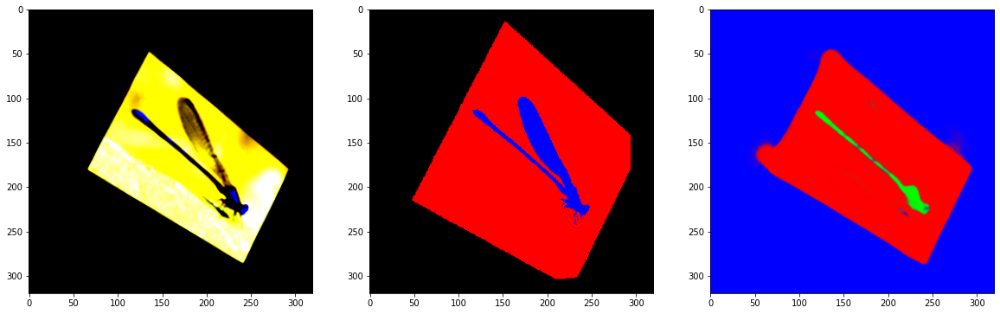

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


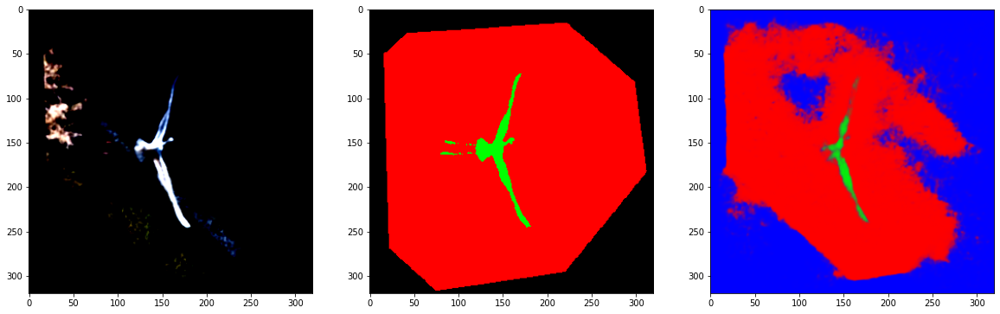

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


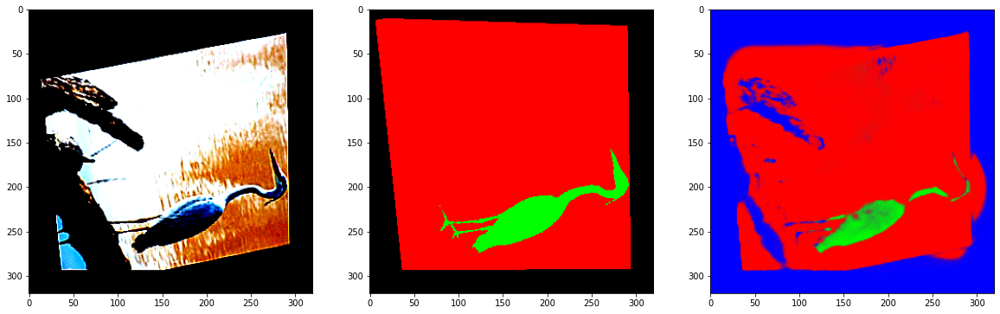

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


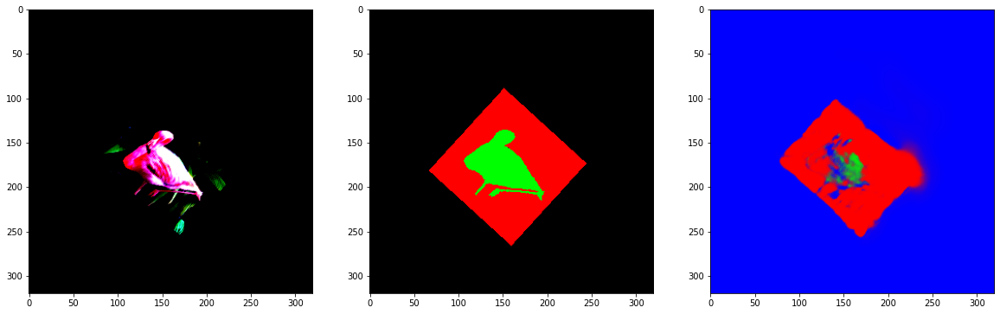

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


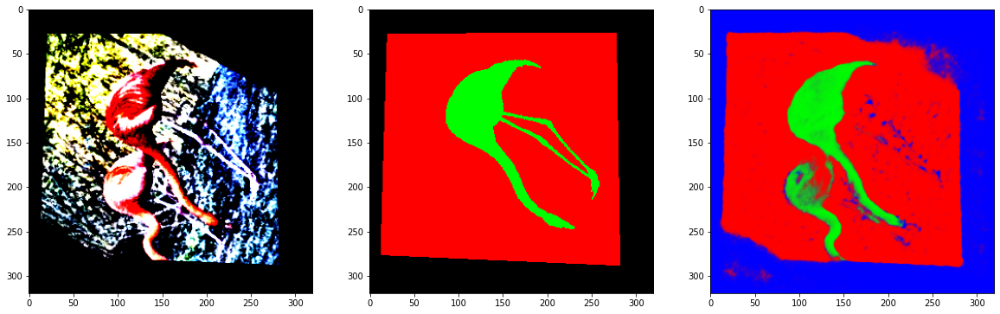

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


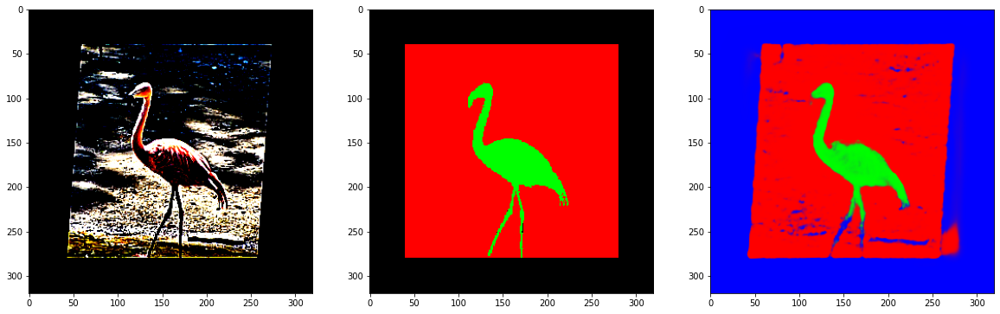

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


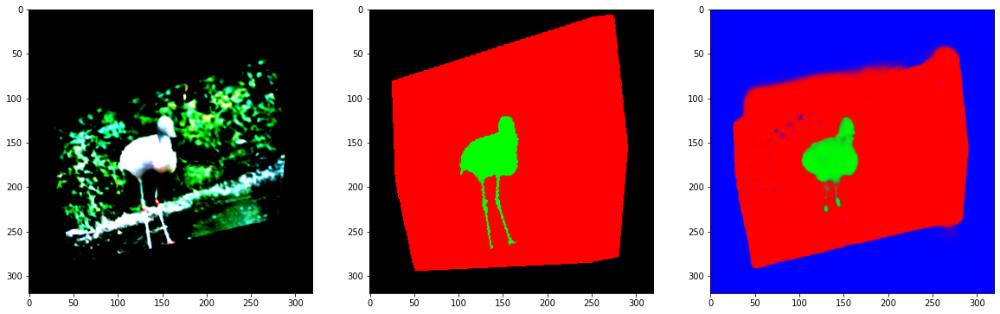

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


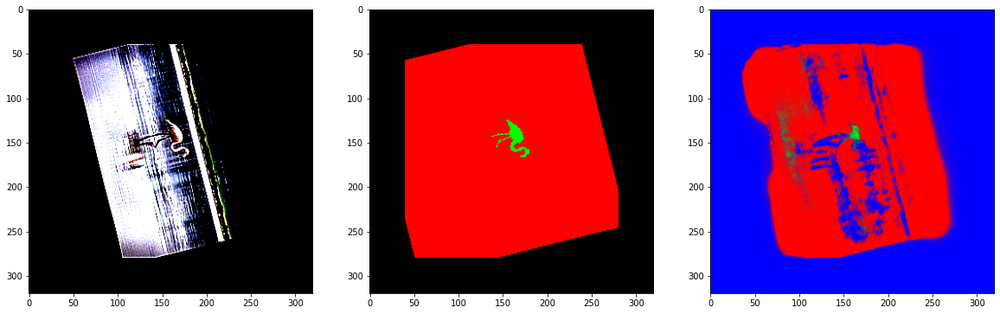

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


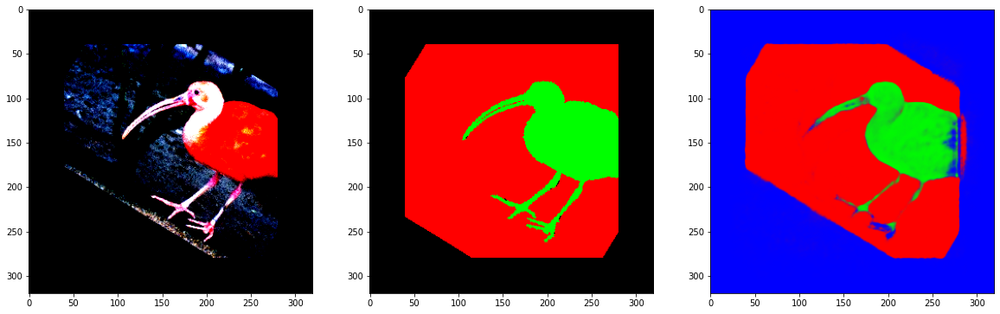

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


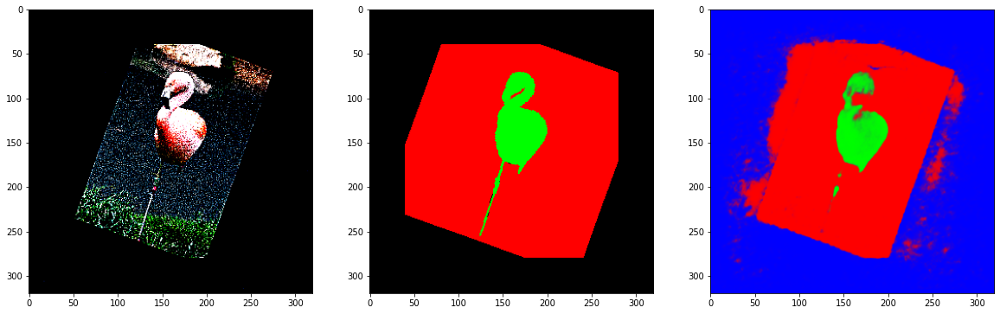

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


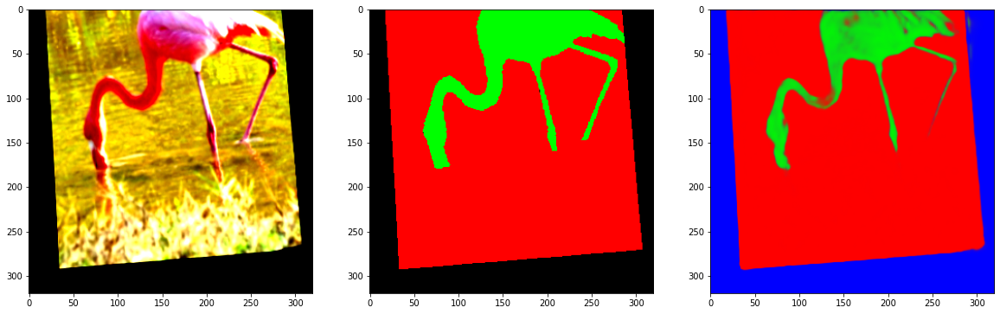

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


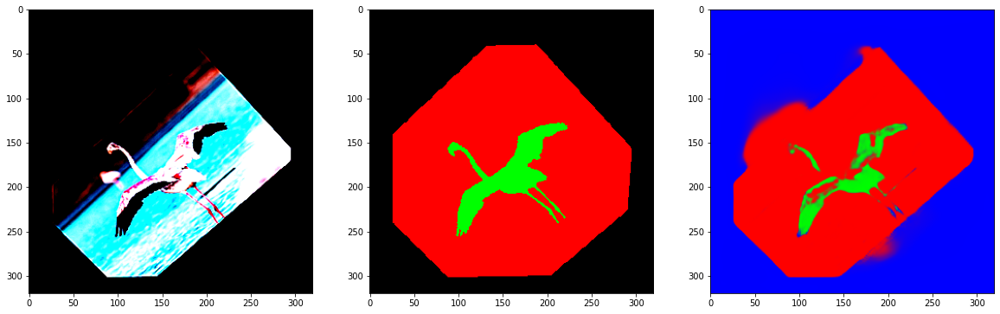

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


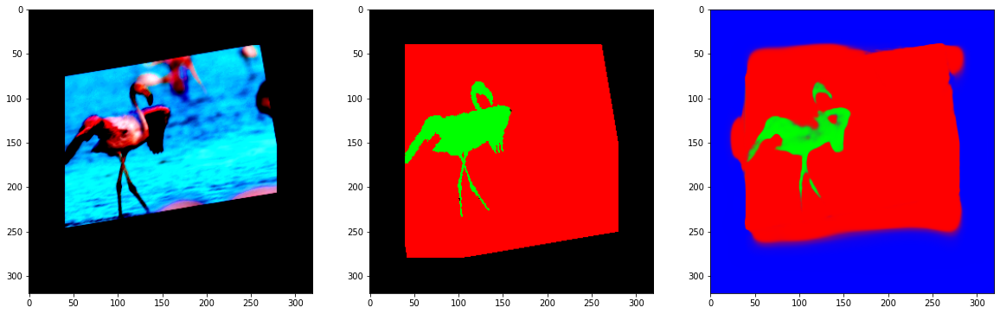

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


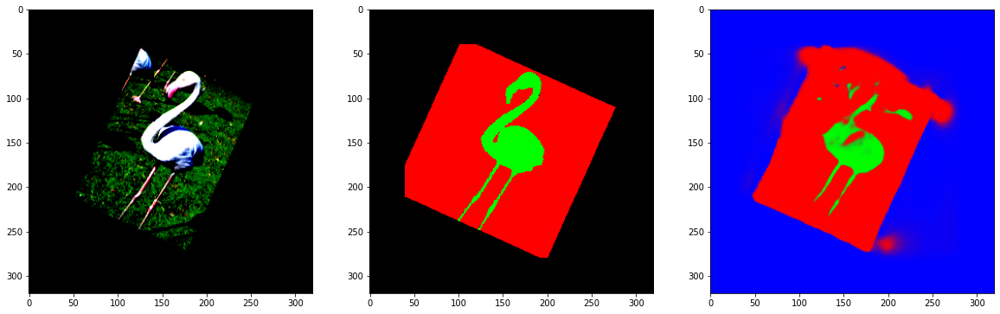

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


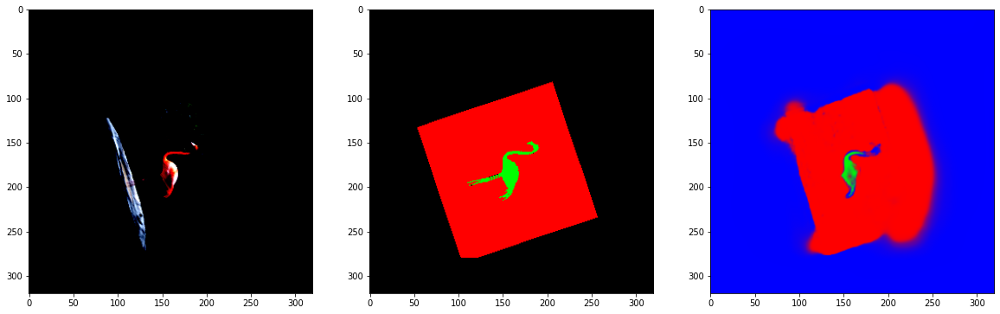

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


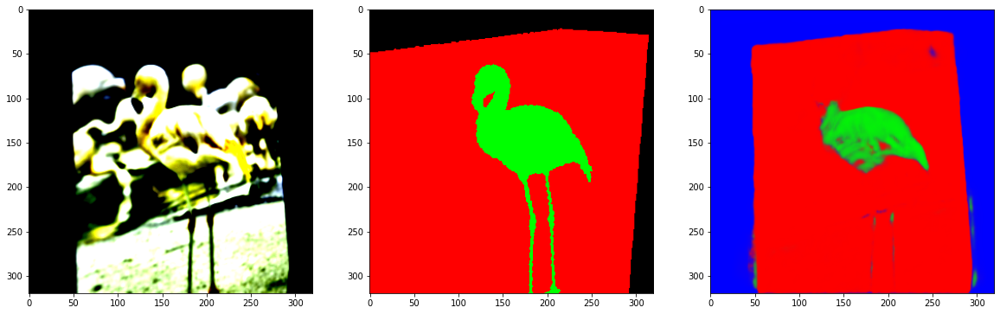

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


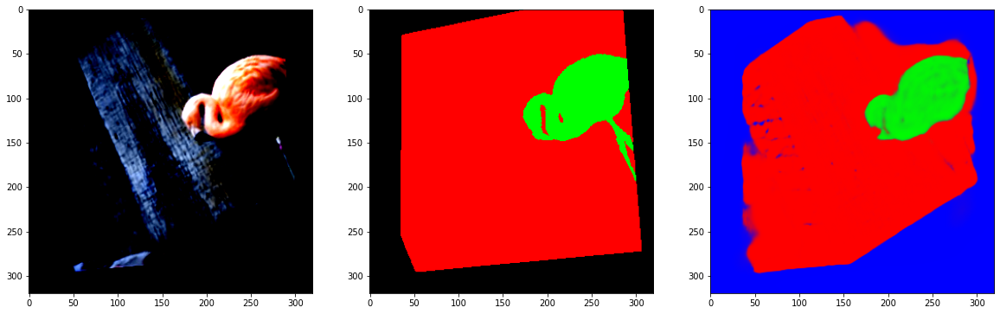

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


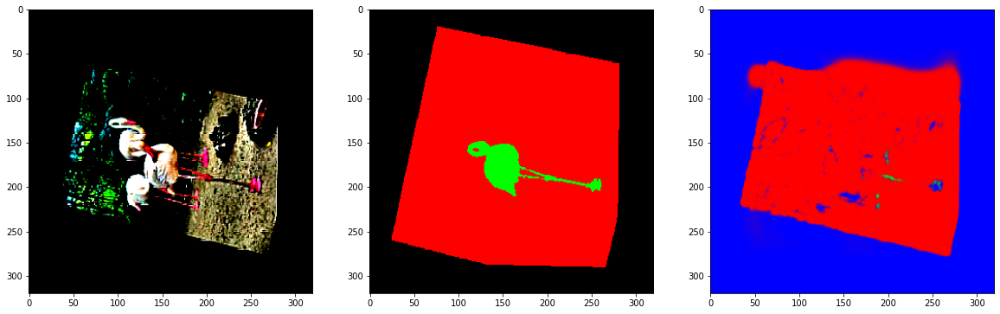

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


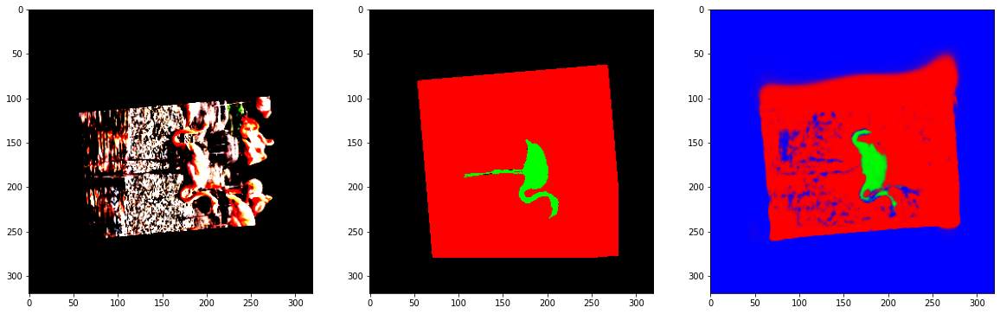

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


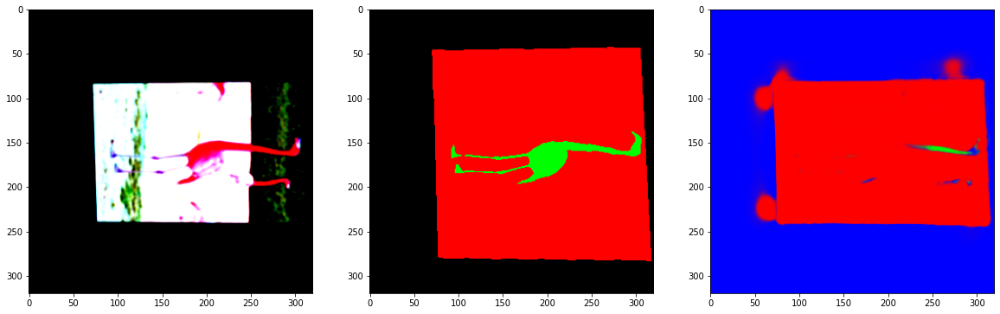

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


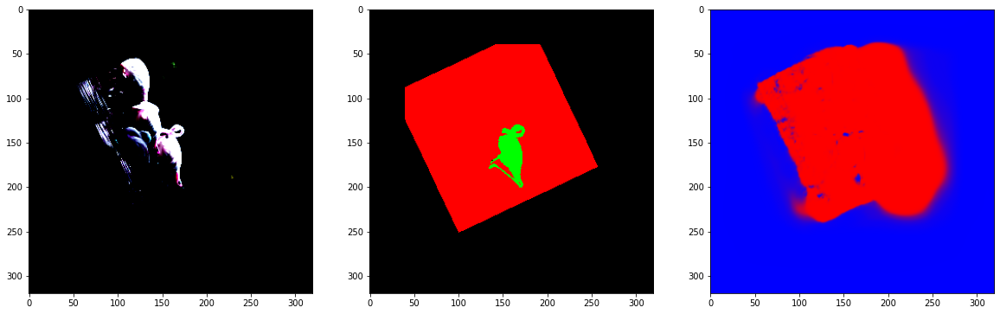

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


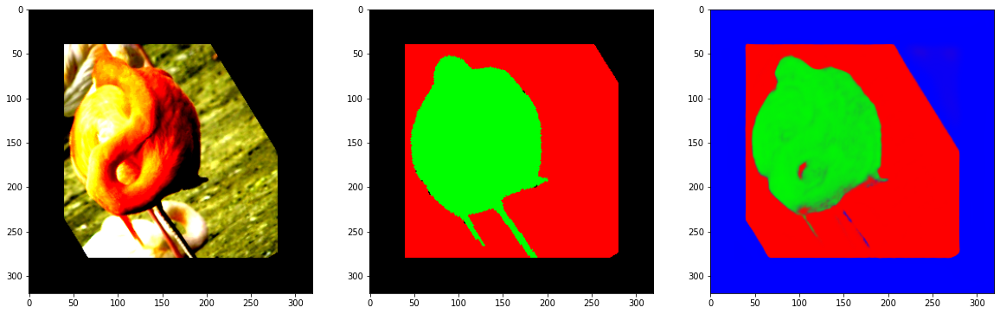

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


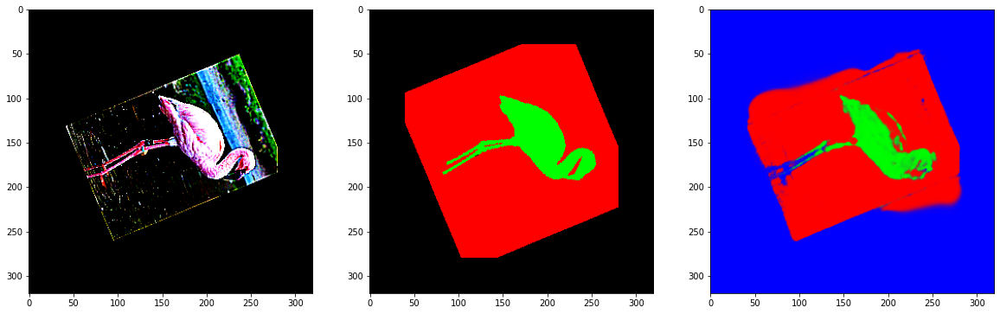

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


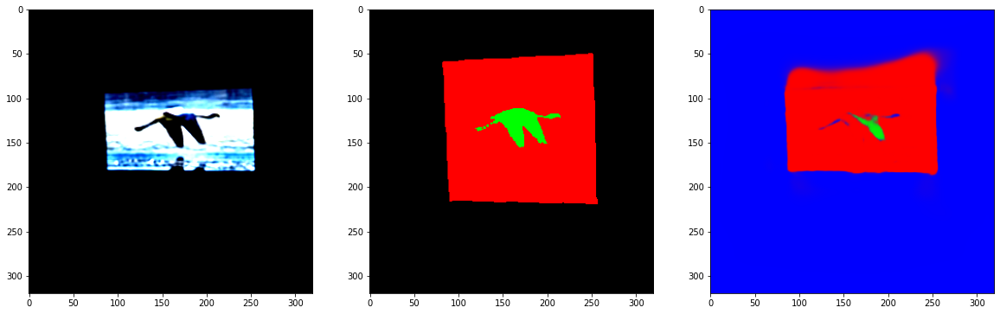

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


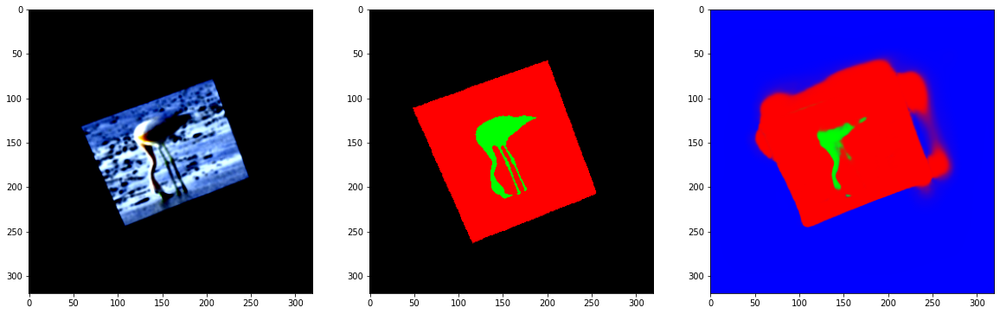

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


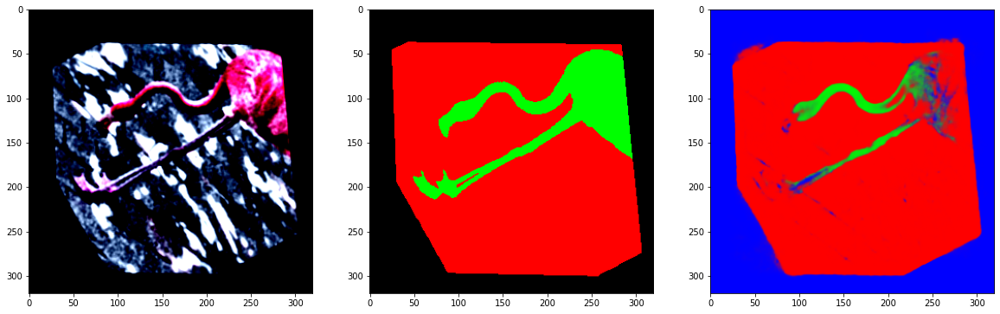

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


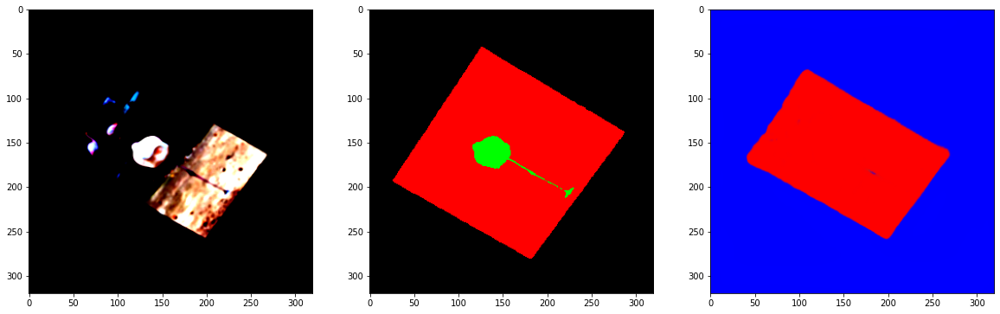

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


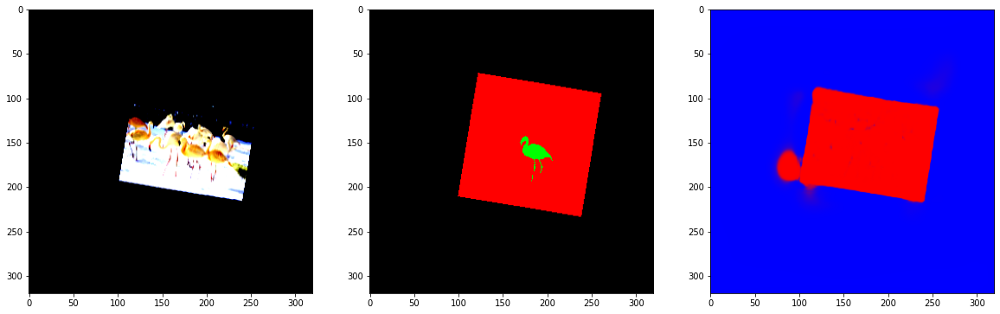

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


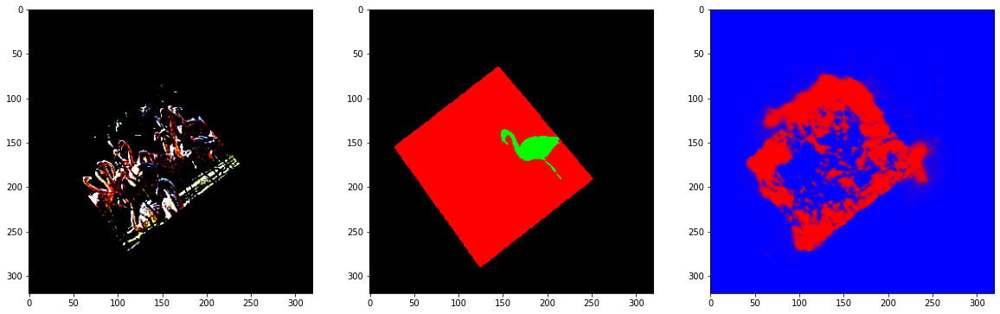

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


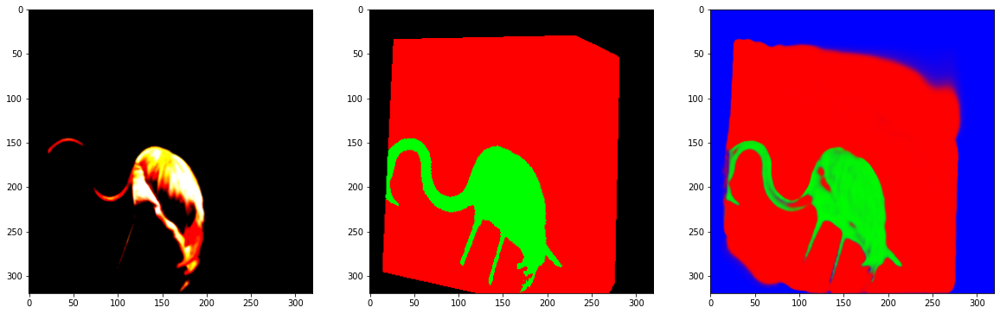

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


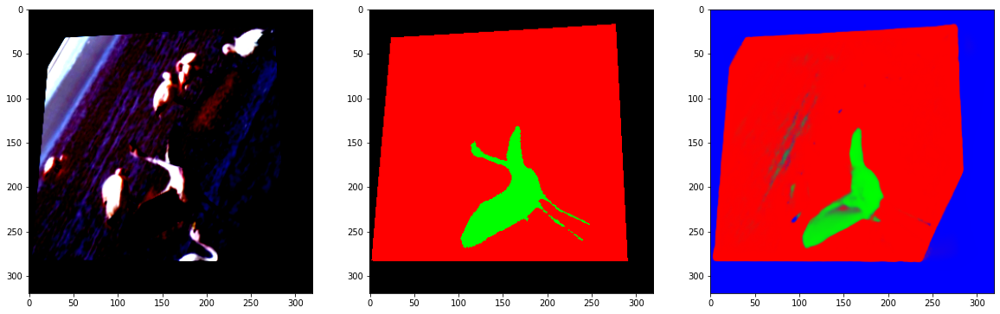

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


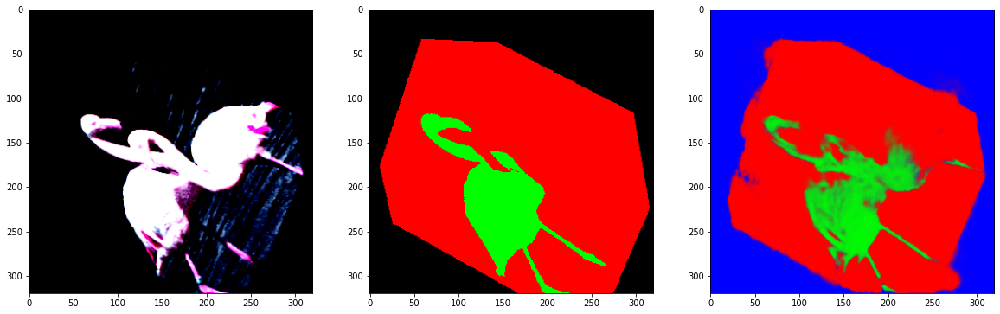

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


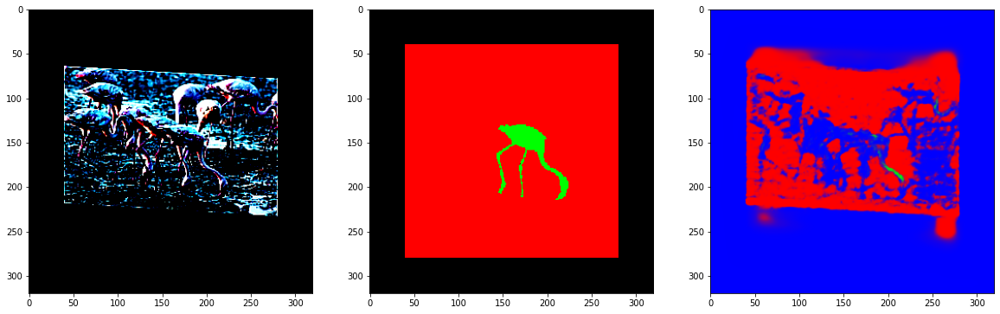

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


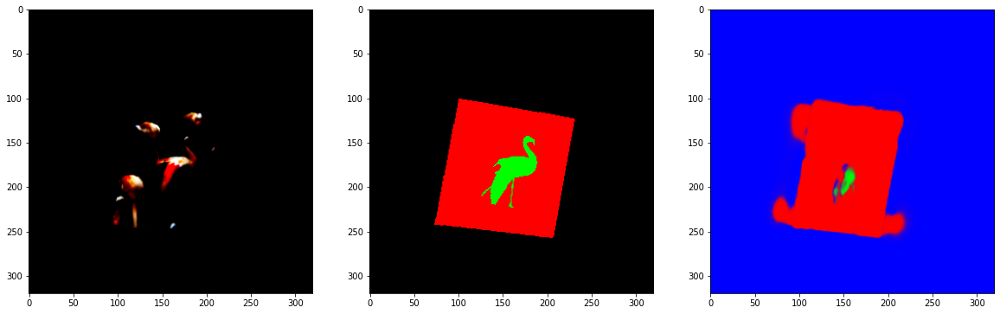

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


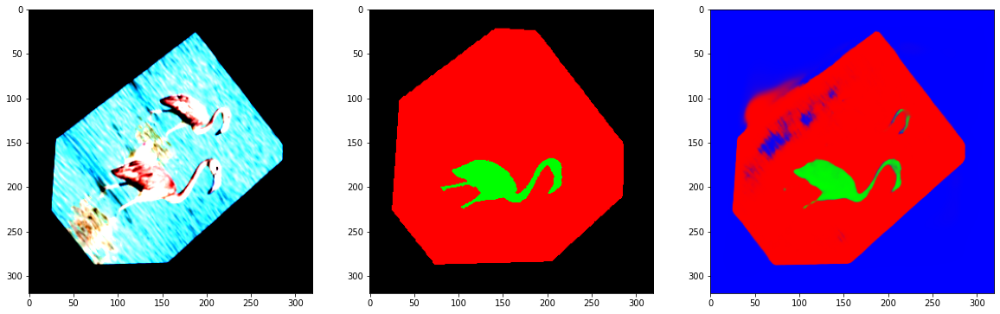

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


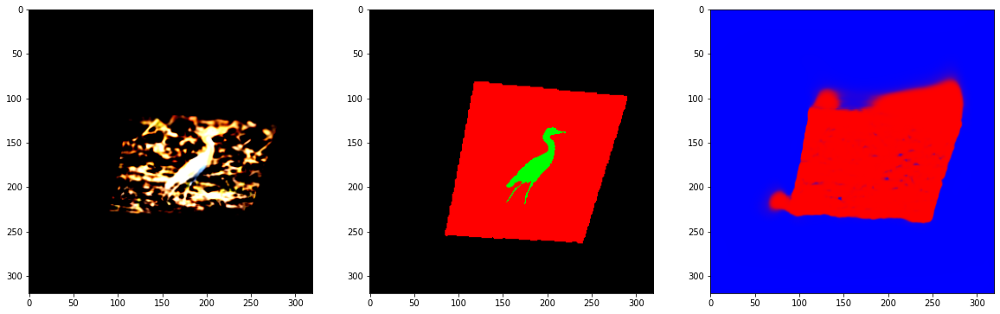

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


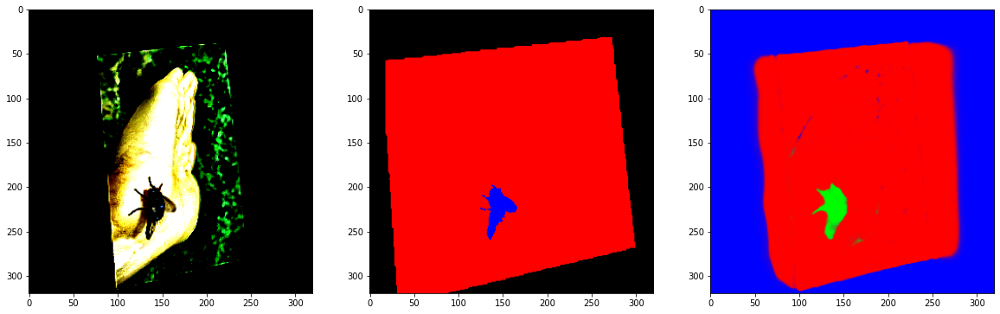

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


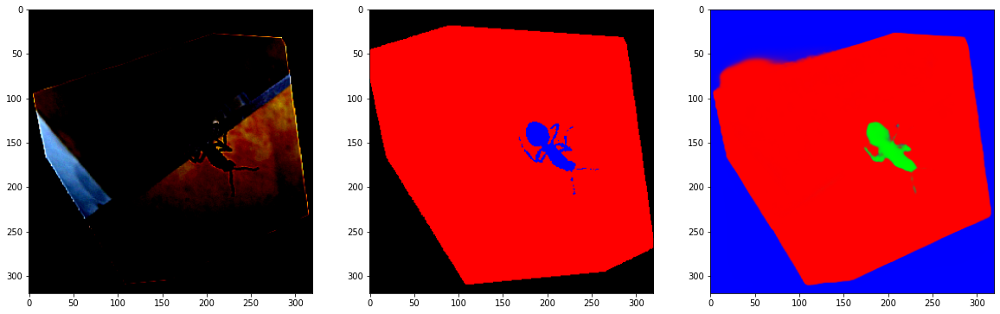

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


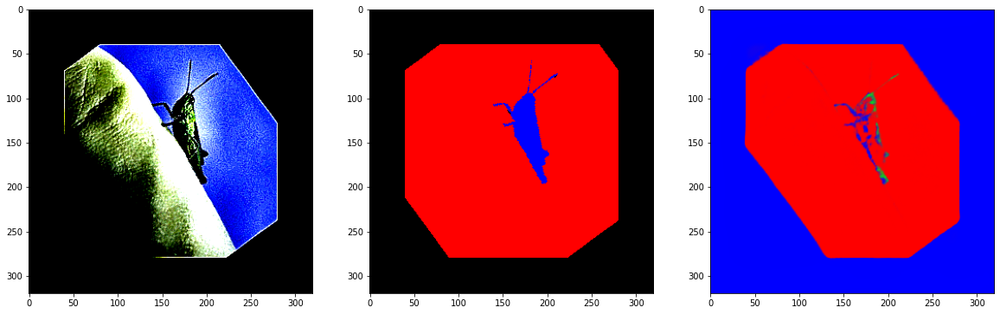

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


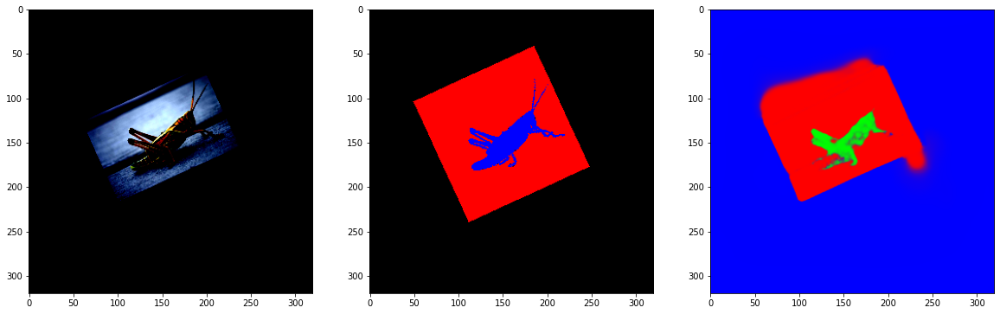

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


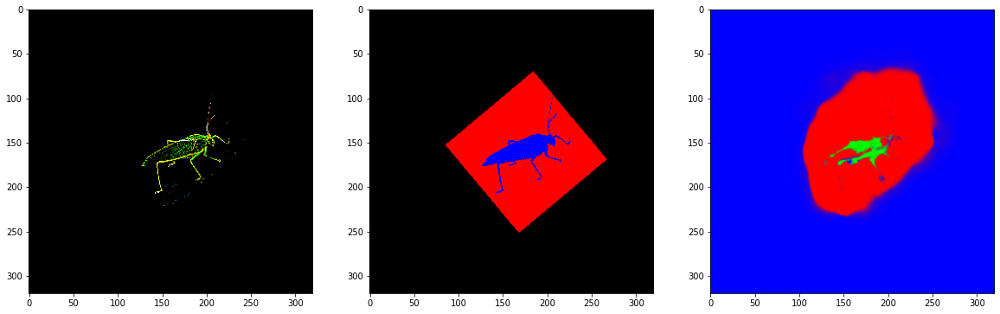

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


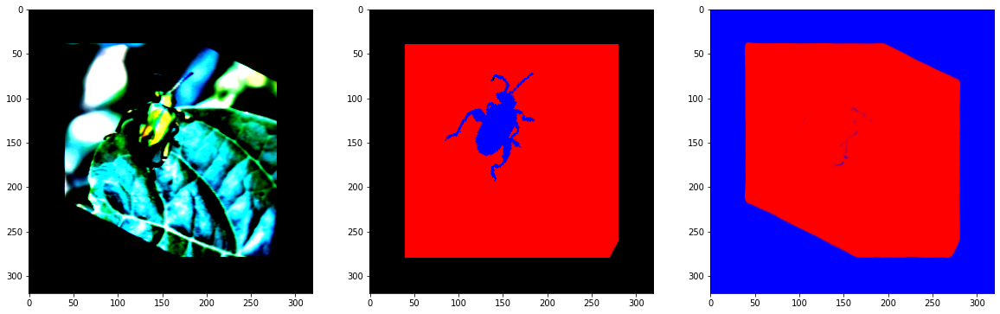

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


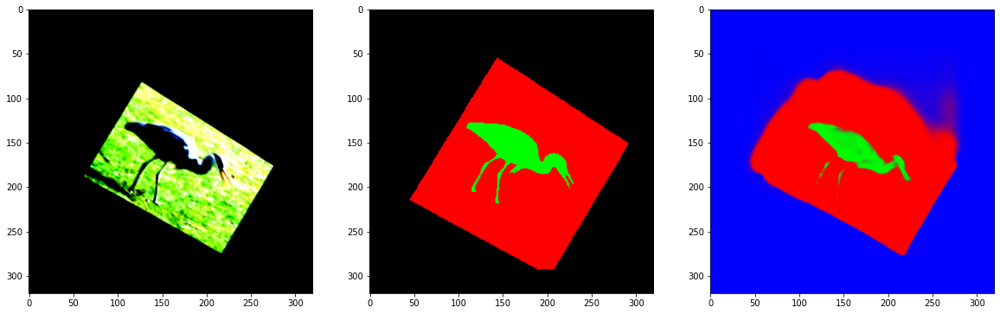

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


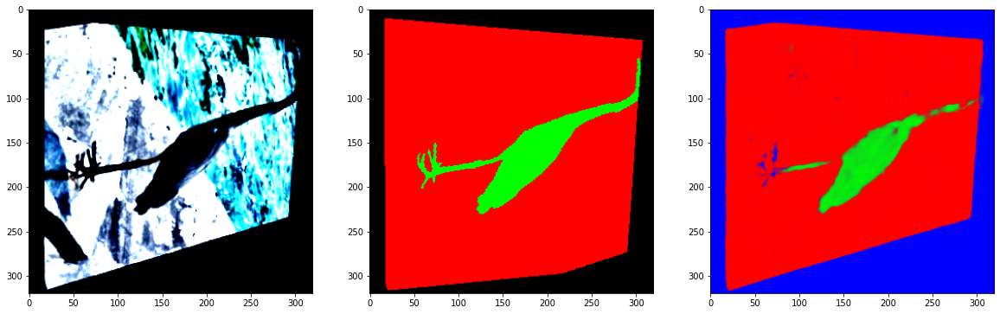

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


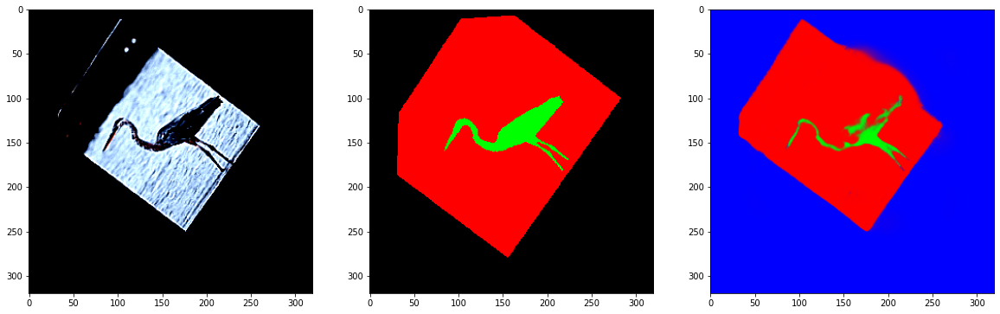

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


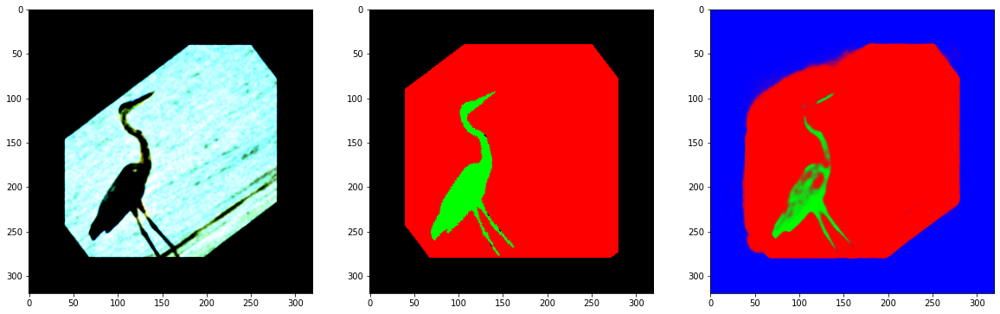

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


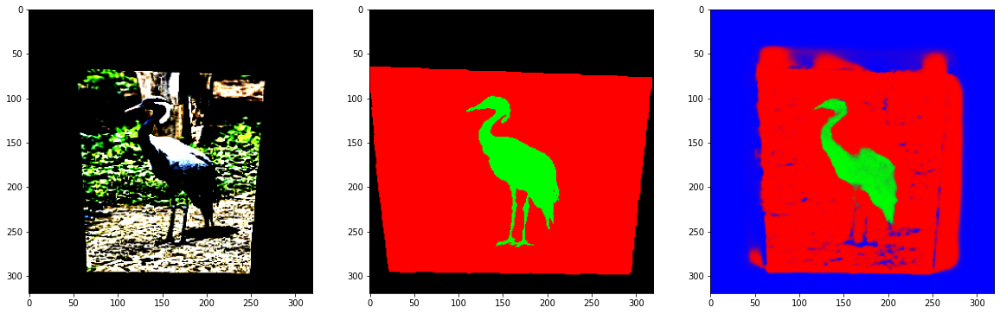

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


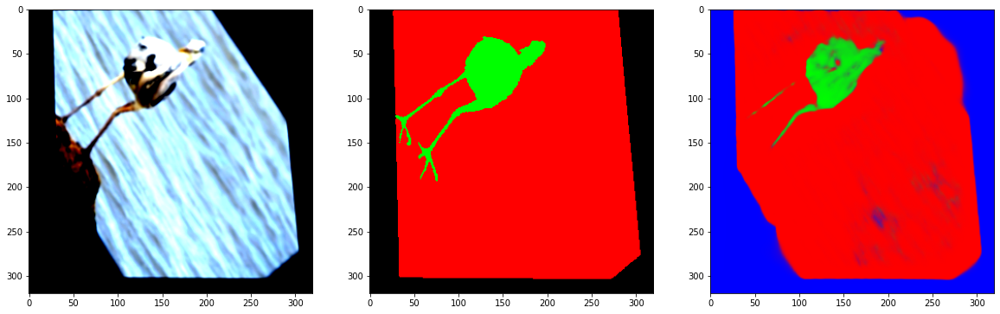

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


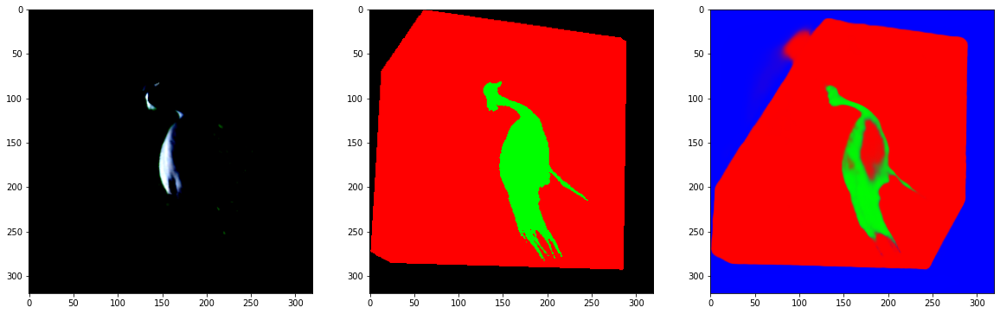

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


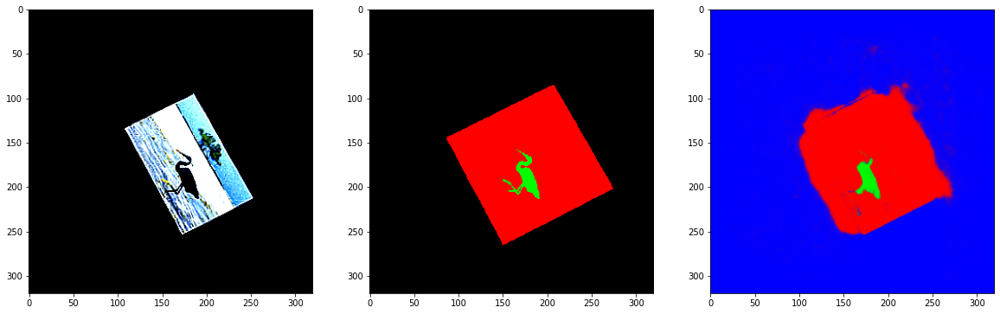

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


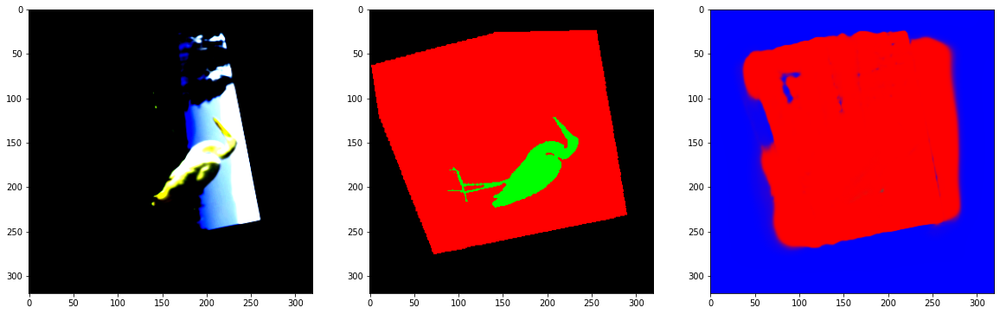

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


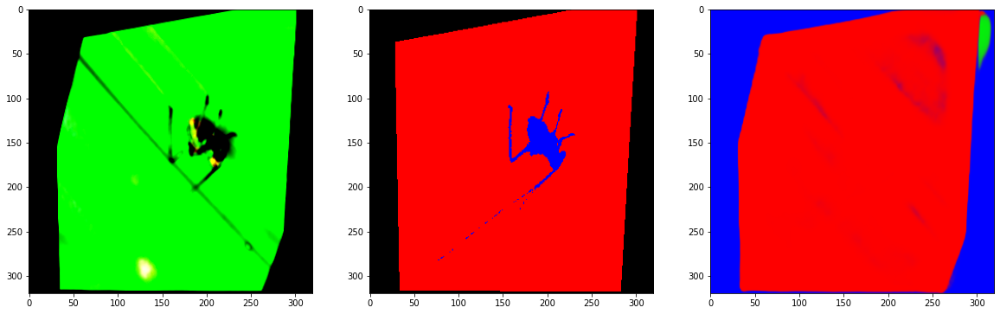

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


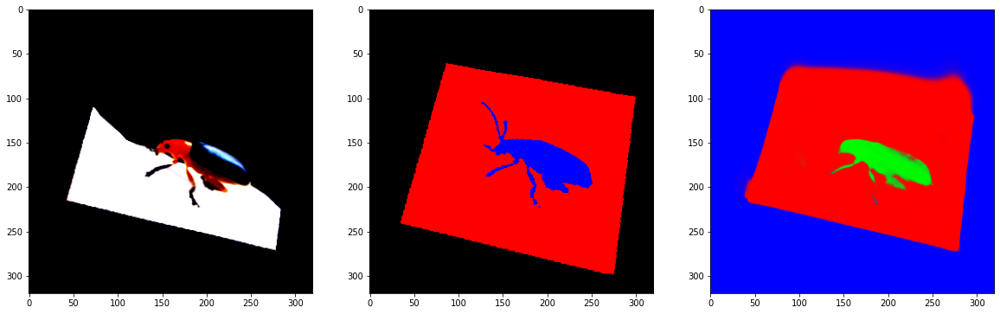

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


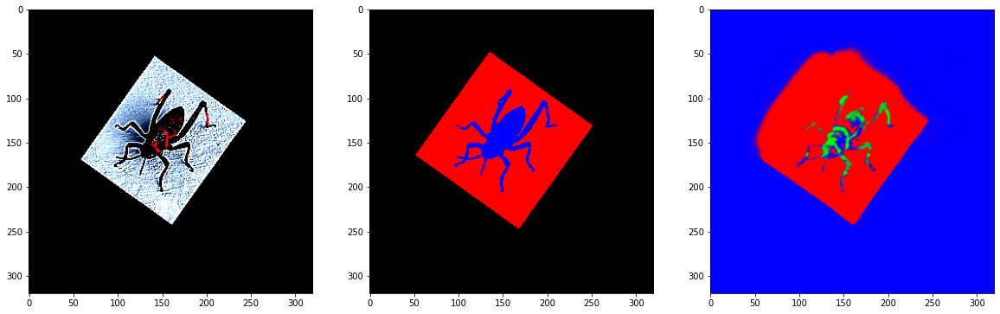

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


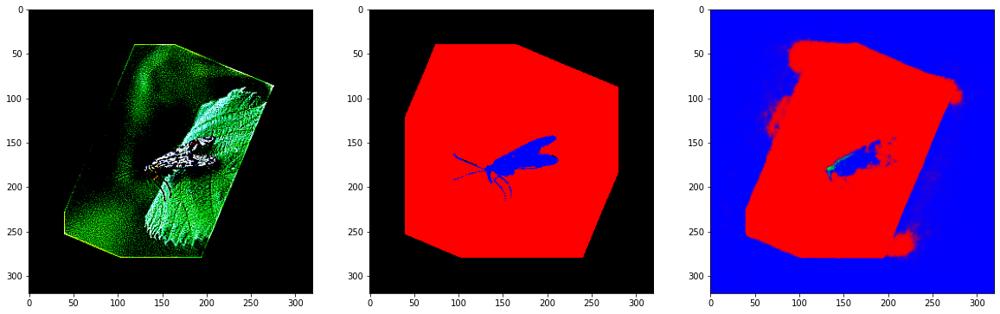

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


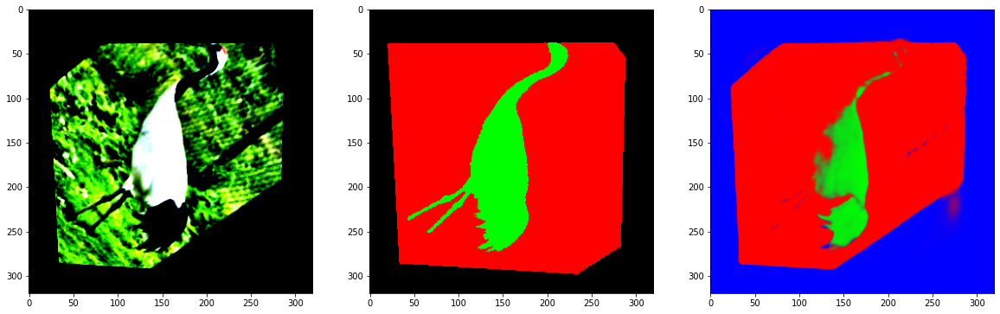

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


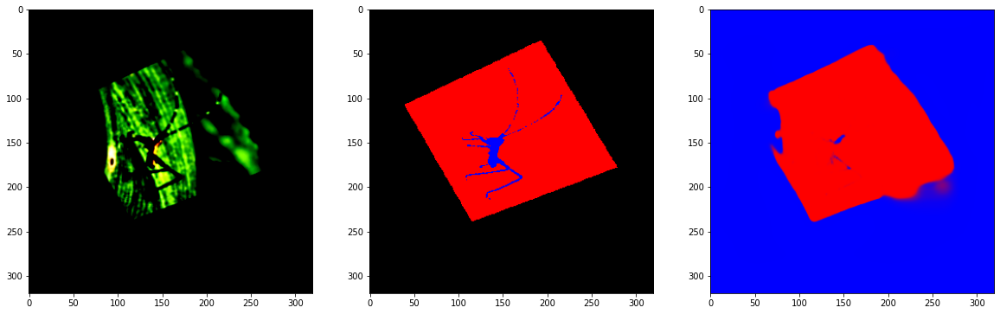

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


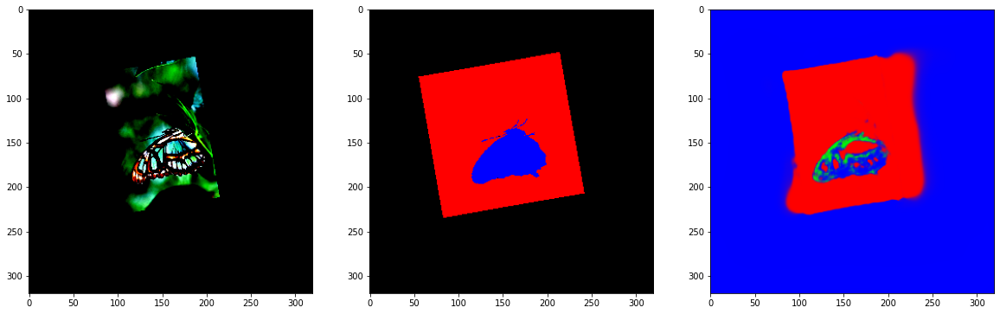

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


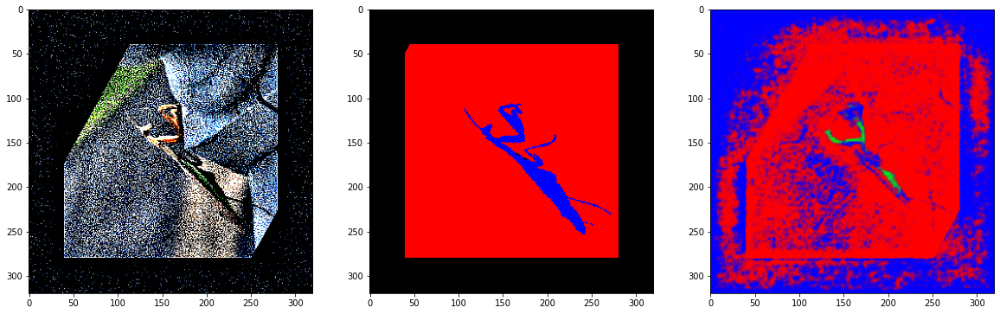

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


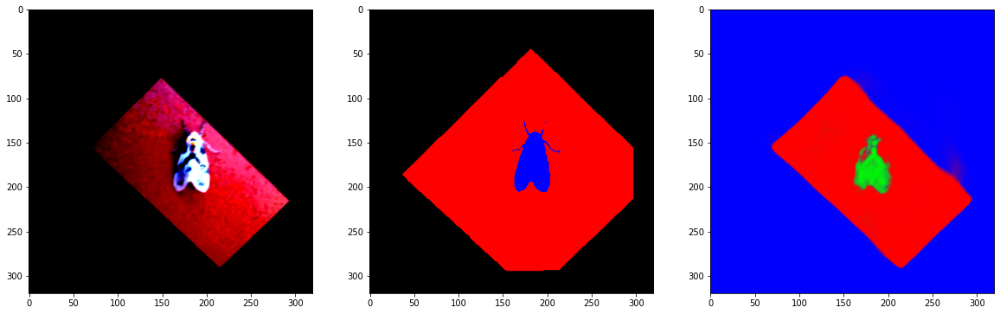

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


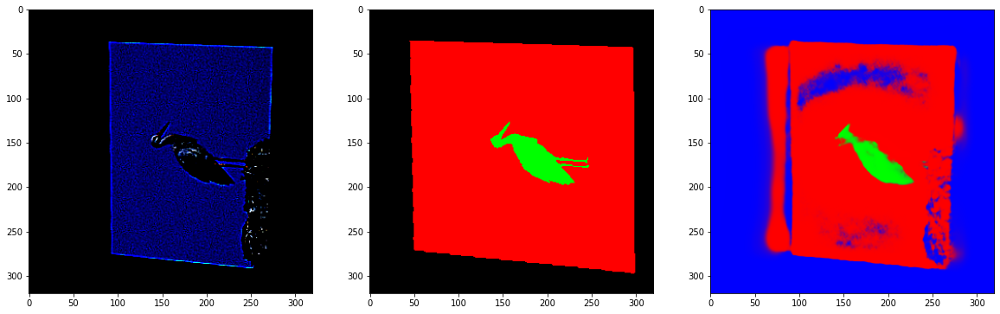

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


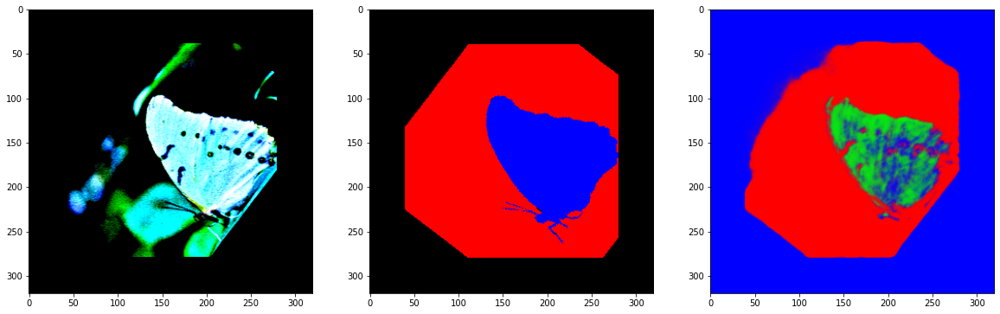

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


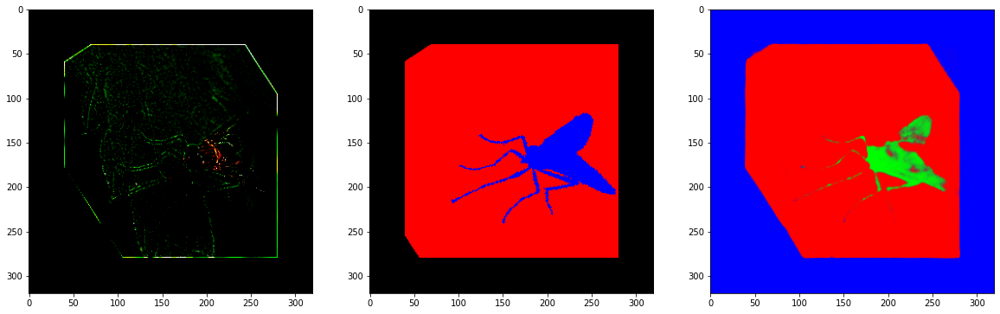

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


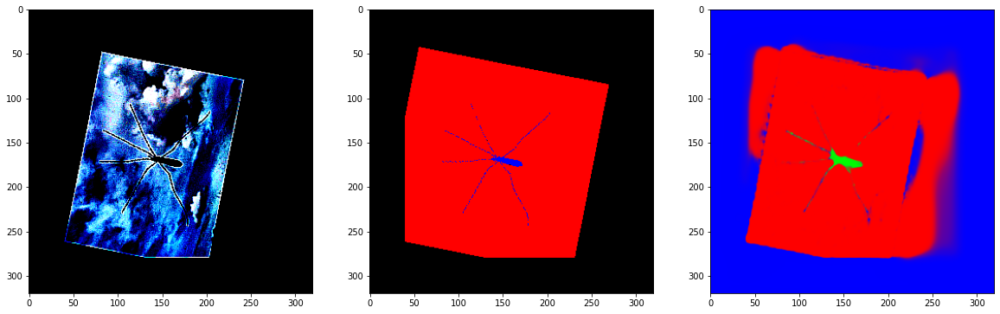

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


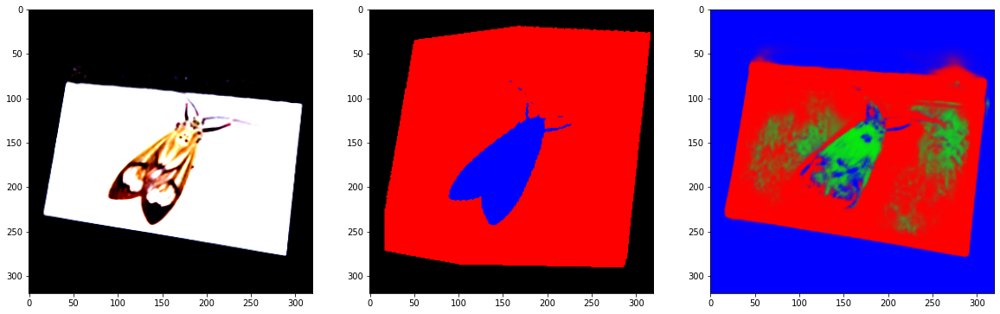

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


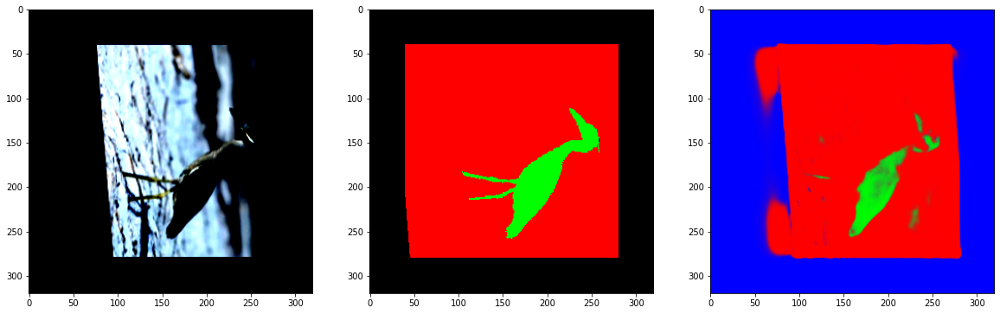

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


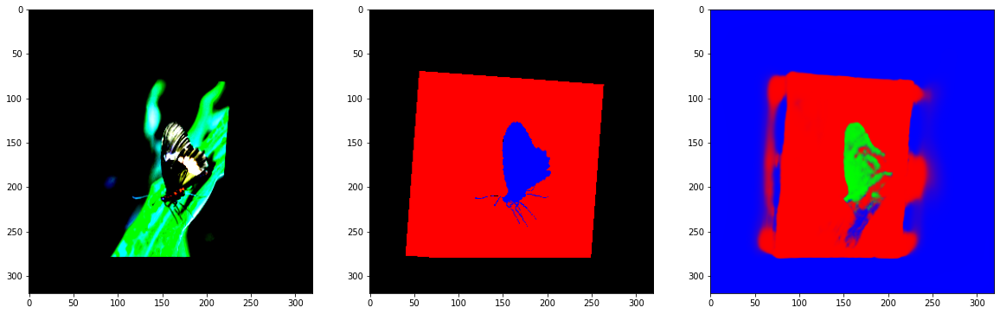

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


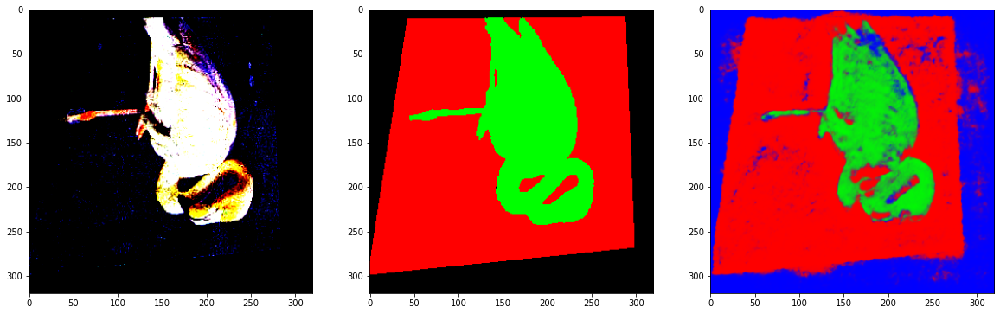

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


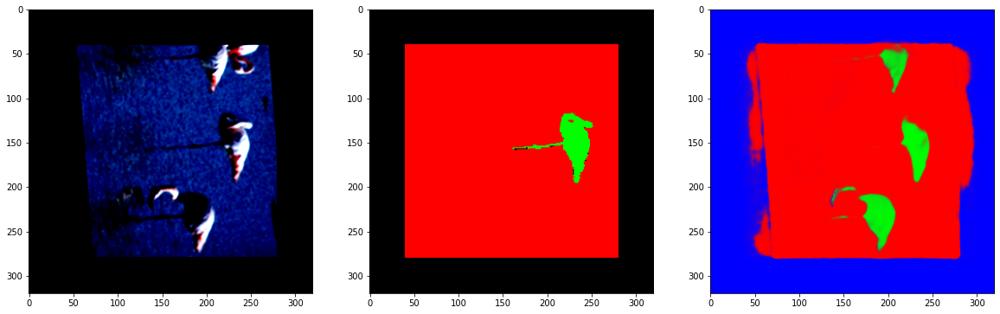

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


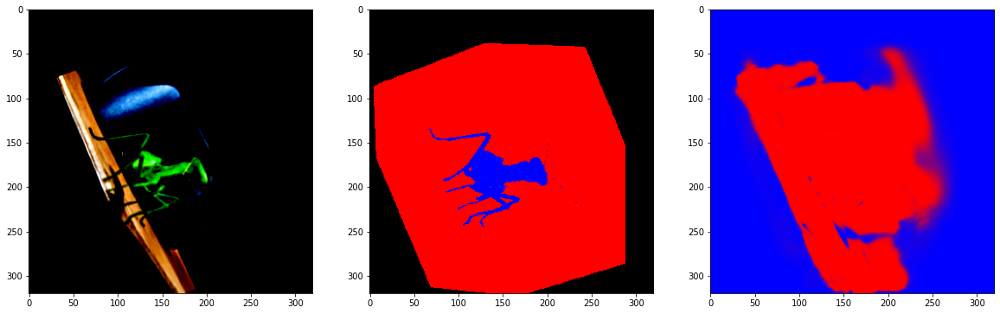

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


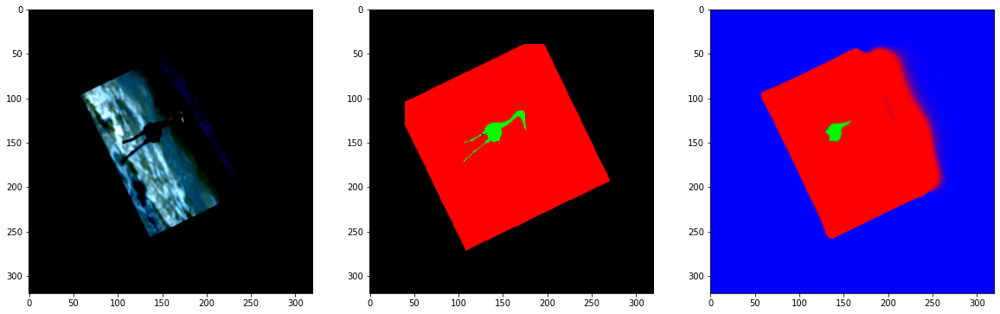

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


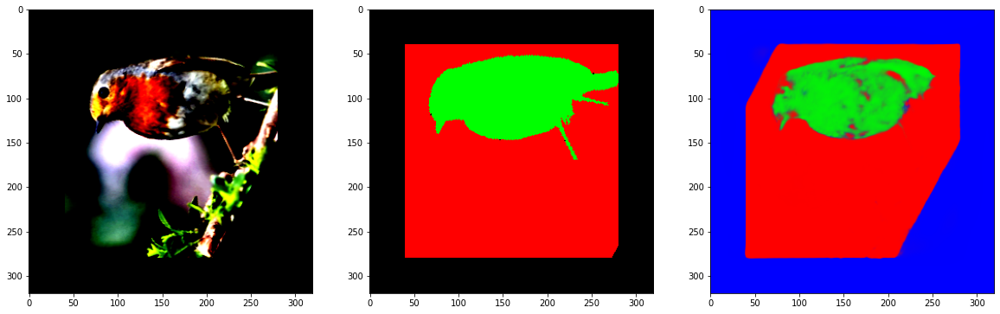

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


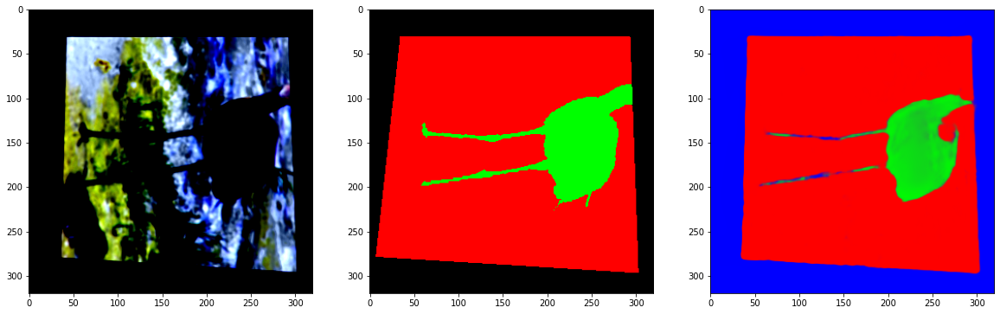

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


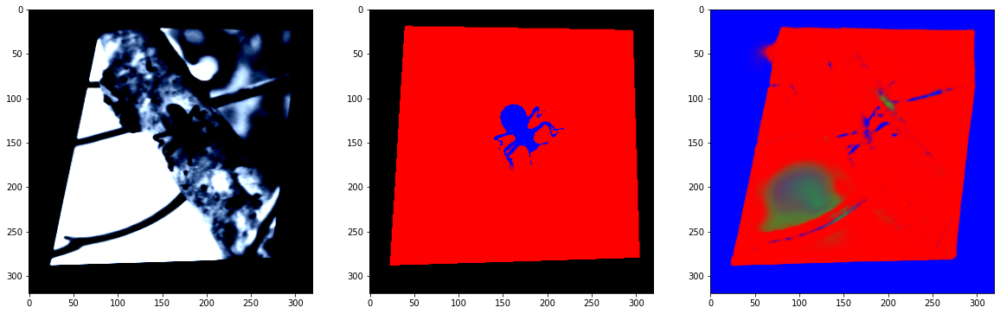

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


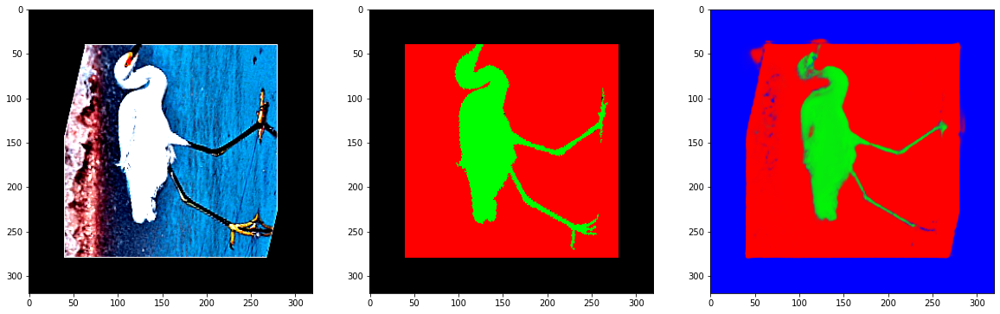

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


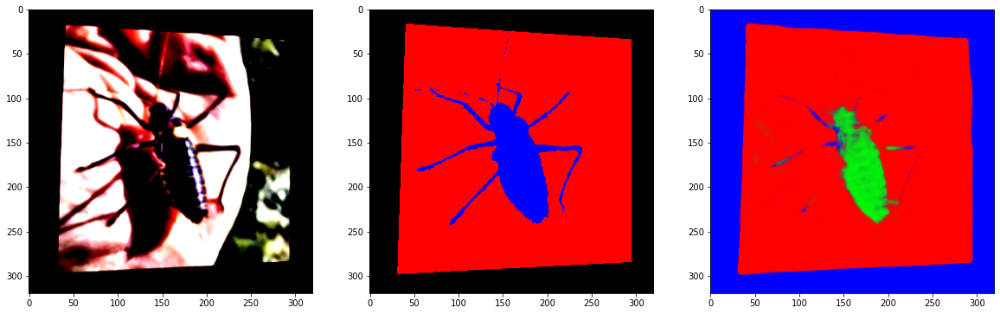

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


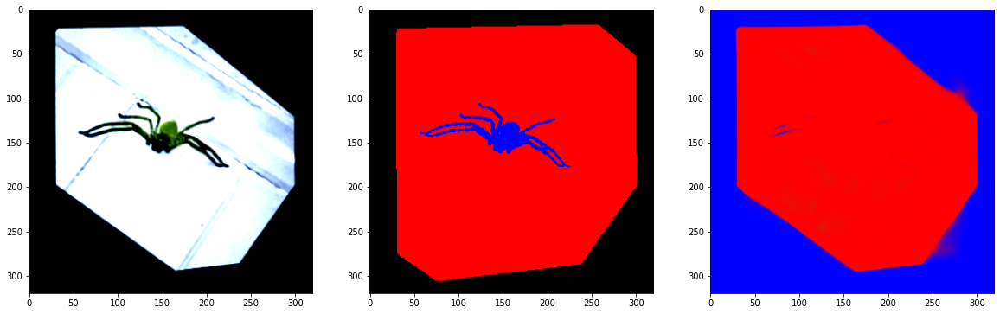

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


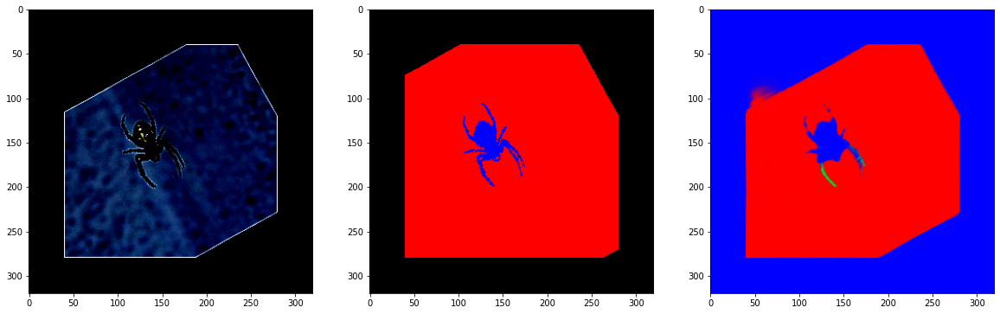

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


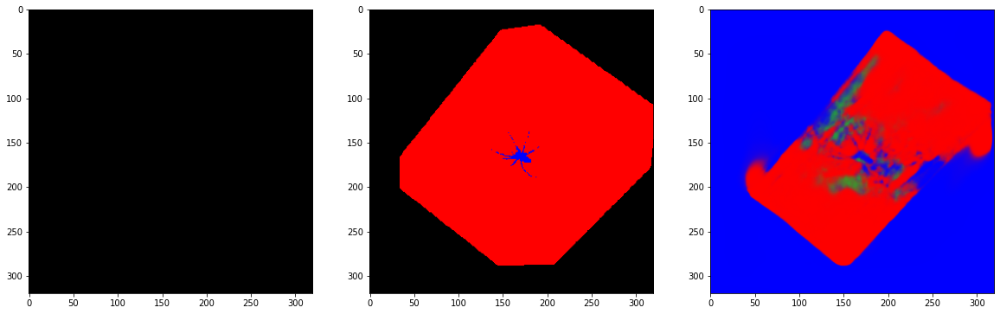

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


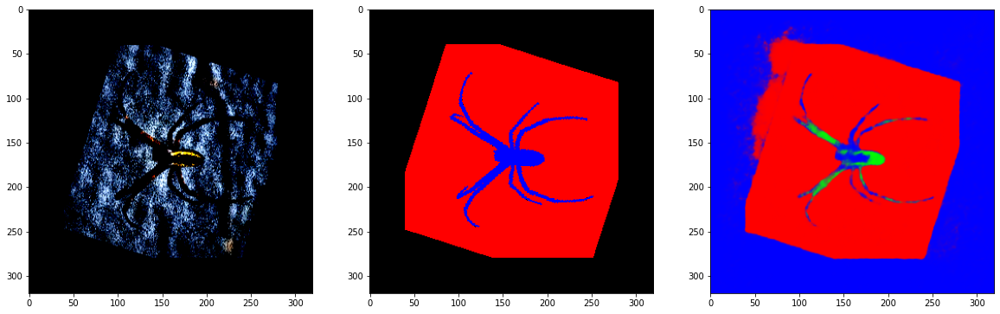

(1, 320, 320, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


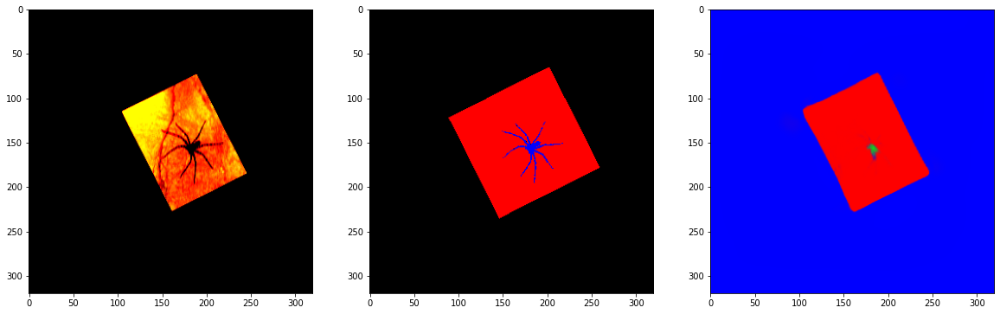

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


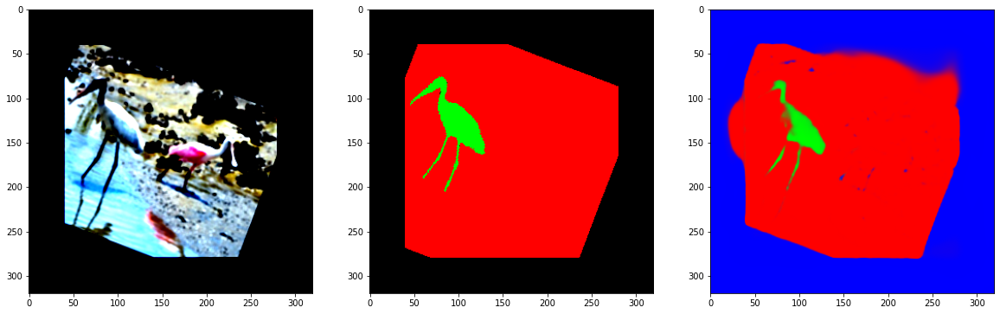

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


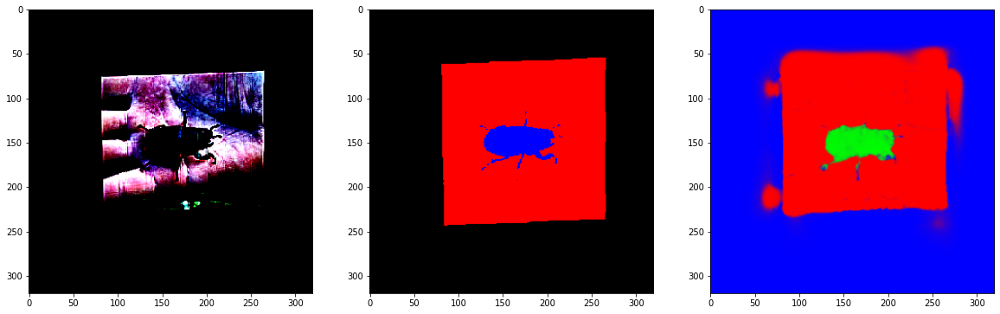

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


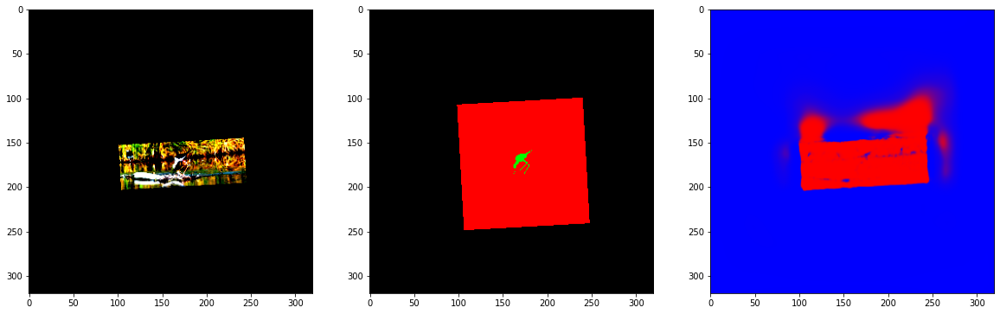

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


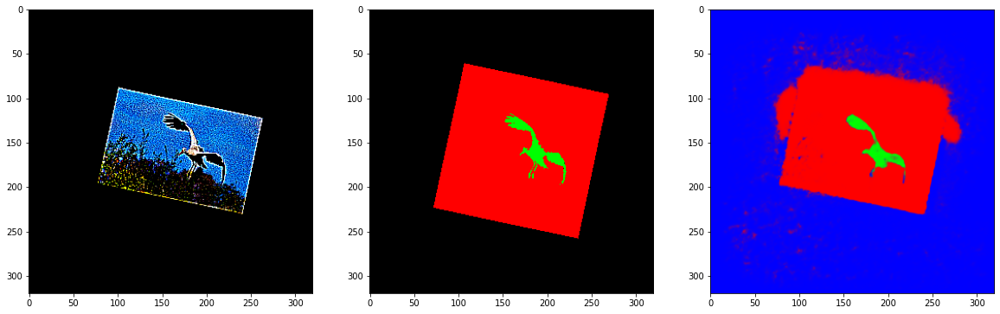

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


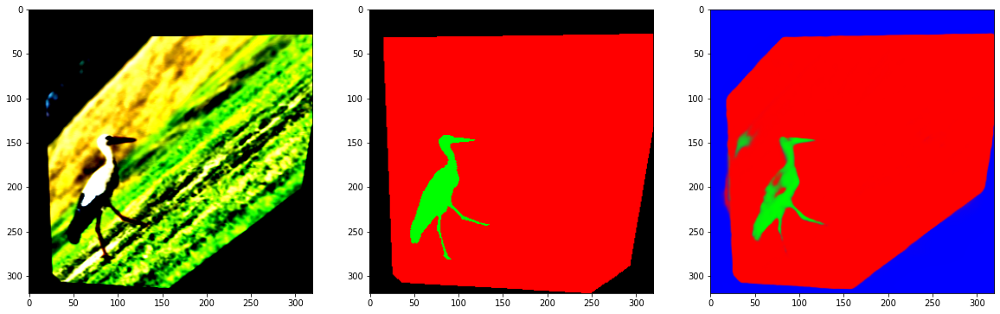

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 320, 320, 3)


KeyboardInterrupt: ignored

In [46]:
for sample, mask in train_dataset:
    print(np.expand_dims(sample, axis=0).shape)
    pred = model.predict(np.expand_dims(sample, axis=0))
    f, ax = plt.subplots(1, 3, figsize = (20, 10))
    ax[0].imshow(sample.astype('float64'))
    ax[1].imshow(mask)
    ax[2].imshow(pred[0])
    plt.show()


In [43]:
# Dataset for validation images
test_dataset = Dataset(
    '{}//test'.format(DATA_DIR),
    '{}//testannot'.format(DATA_DIR),
    reshape = (320, 320)
)

test_dataloader = Dataloader(test_dataset, batch_size=1, shuffle=False)

(1, 320, 320, 3)


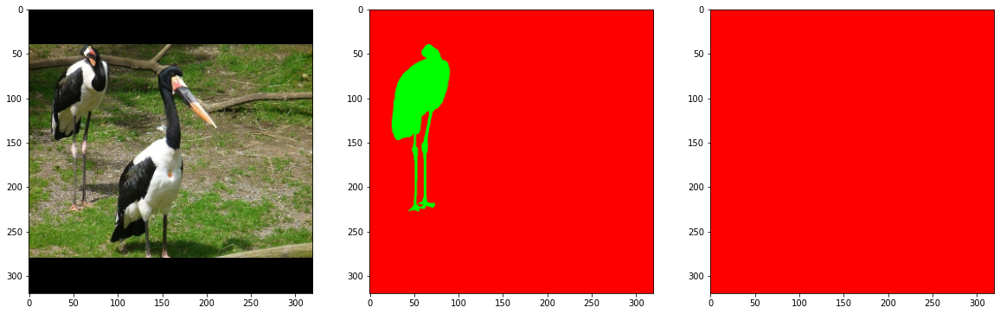

(1, 320, 320, 3)


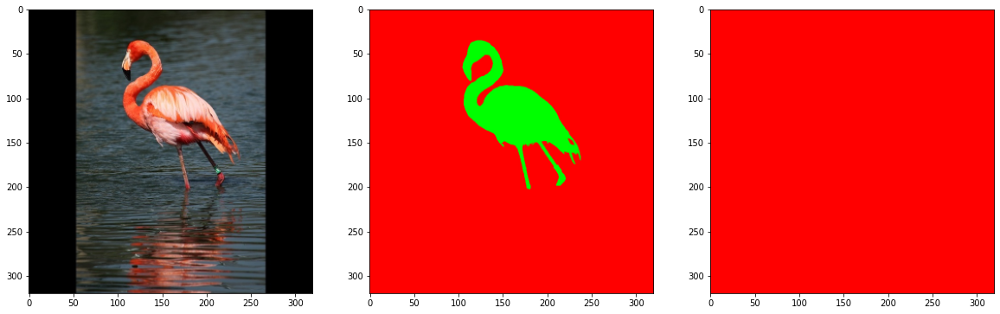

(1, 320, 320, 3)


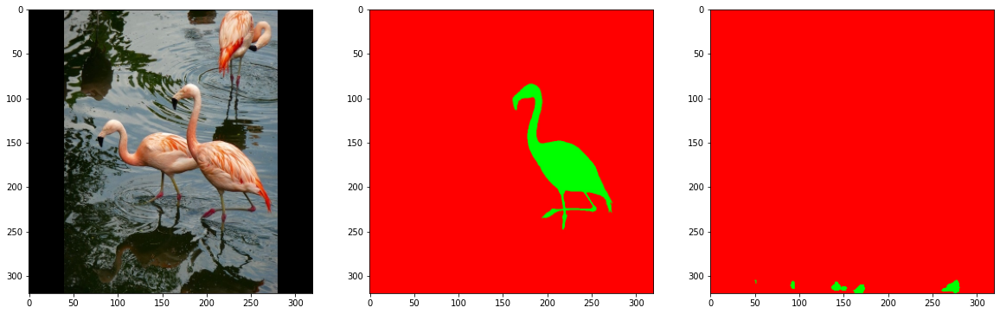

(1, 320, 320, 3)


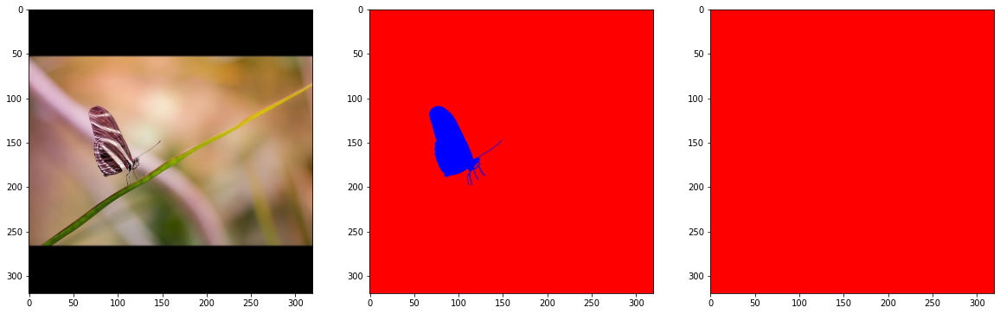

(1, 320, 320, 3)


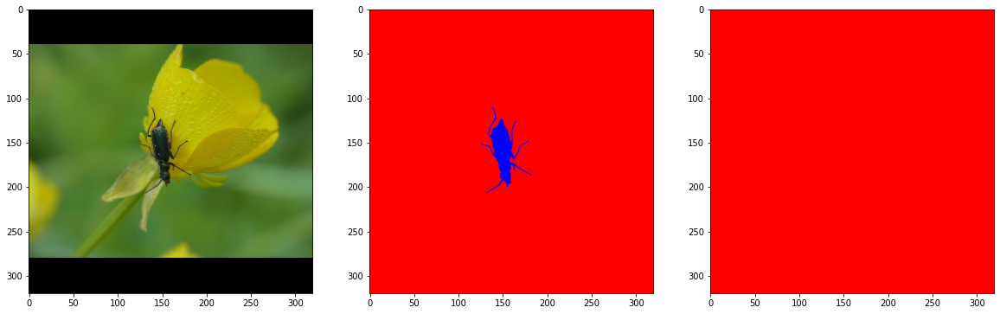

(1, 320, 320, 3)


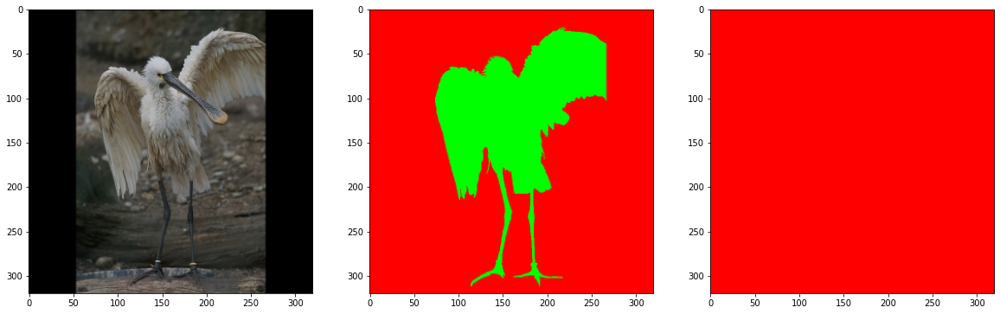

(1, 320, 320, 3)


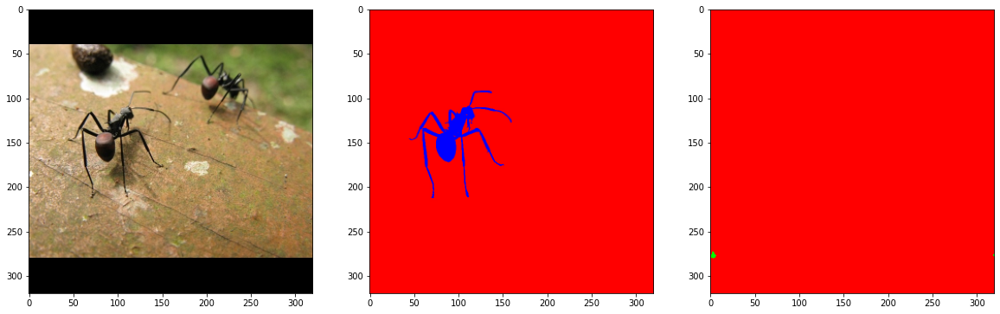

(1, 320, 320, 3)


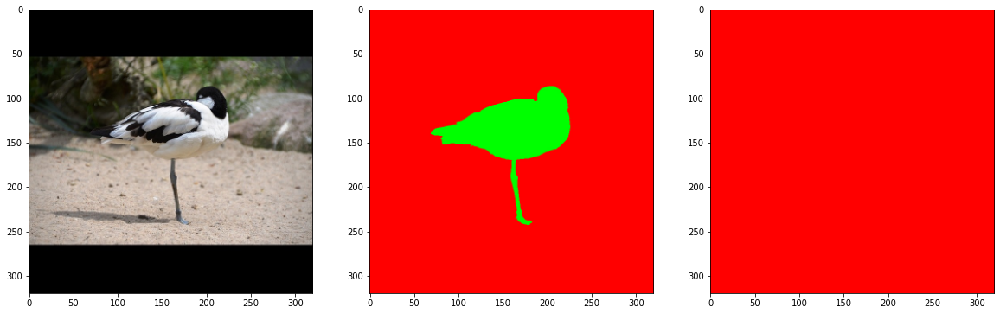

(1, 320, 320, 3)


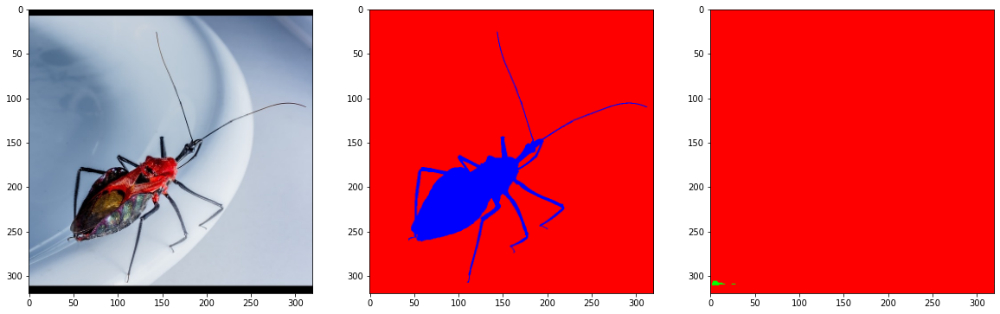

(1, 320, 320, 3)


In [ ]:
for sample, mask in test_dataset:
    print(np.expand_dims(sample, axis=0).shape)
    pred = model.predict(np.expand_dims(sample, axis=0).astype(np.float64))
    f, ax = plt.subplots(1, 3, figsize = (20, 10))
    ax[0].imshow(sample.astype(np.float64))
    ax[1].imshow(mask)
    ax[2].imshow(pred[0])
    plt.show()


In [49]:
pred = model.predict_generator(test_dataset)

AttributeError: ignored

In [ ]:
visualize(testGen[3][0][0:5], pred[15:20], title = 'Prediction')

In [ ]:
plt.imshow(pred[0][:, :, 0], cmap = 'gray')

In [ ]:
plt.imshow(pred[0][:, :, 1], cmap = 'gray')

In [ ]:
plt.imshow(pred[0][:, :, 2], cmap = 'gray')